 # **1: Initialisation**


In [ ]:
%matplotlib inline
%config InlineBackend.figure_format = 'svg'

# import warnings
# warnings.filterwarnings('ignore')
!pip install smogn
!pip install lightgbm
!pip install kneed

import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
import math
import scipy.stats as stats

from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectFromModel
from sklearn.impute import SimpleImputer

# from imblearn.over_sampling import SMOTE
# !pip install lifelines
# from lifelines import NelsonAalenFitter, CoxPHFitter, KaplanMeierFitter
# from lifelines.statistics import logrank_test
from sklearn.ensemble import IsolationForest
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve, roc_auc_score, fbeta_score
from sklearn.metrics import classification_report
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

import smogn

from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression, LassoCV

import lightgbm as lgb
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV, cross_val_score, KFold, RandomizedSearchCV

from sklearn.preprocessing import StandardScaler
from scipy import stats
from kneed import KneeLocator
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras.optimizers import Adam

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, davies_bouldin_score
from kneed import KneeLocator

import pandas as pd
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.cluster import KMeans

In [ ]:
application = pd.read_csv("/content/application_record.csv")
credit = pd.read_csv("/content/credit_record.csv")

In [ ]:
!dir

application_record.csv	credit_record.csv  sample_data


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: Error: credential propagation was unsuccessful

In [ ]:
application = pd.read_csv("drive/MyDrive/Colab Notebooks/input/application_record.csv")
credit = pd.read_csv("drive/MyDrive/Colab Notebooks/input/credit_record.csv")

# **2: Exploratory Data Analysis**

## **2.1: Motivation**

Before diving into modeling, it is essential to understand the structure, quality, and distribution of the data. EDA helps us uncover patterns, identify outliers, detect missing values, and assess potential relationships between features and the target variable.

In this section, we will:
- Explore feature relationships that may be important for modeling
- Examine the distribution of key variables (e.g., income, age, credit status)
- Identify any data quality issues such as missing or inconsistent values
- Investigate class imbalance, particularly between good and bad credit clients

These insights will guide our preprocessing steps and inform model design choices later in the project.

In [ ]:
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 100)
# credit = pd.read_csv(r"input/credit_record.csv")
# application = pd.read_csv('input/application_record.csv')
credit

,ID,MONTHS_BALANCE,STATUS
0,5001711,0,X
1,5001711,-1,0
2,5001711,-2,0
3,5001711,-3,0
4,5001712,0,C
...,...,...,...
1048570,5150487,-25,C
1048571,5150487,-26,C
1048572,5150487,-27,C
1048573,5150487,-28,C



## **2.2: Credit Dataset**

### **2.1.1 Original Features**

#### Months_Balance: The month that the data was recorded on
  - `[0 to 60]` with `0` being the first month and `60` being the most recent month


#### Status: Degree of credit delinquency
- `0`: 1-29 days past due  
- `1`: 30-59 days past due  
- `2`: 60-89 days overdue  
- `3`: 90-119 days overdue  
- `4`: 120-149 days overdue  
- `5`: Overdue or bad debts, write-offs for more than 150 days  
- `C`: Paid off that month  
- `X`: No loan for the month  

### **2.1.2: Feature Engineering**

#### Additional Features:
- `open_month`: The month when credit account was opened
- `end_month`: The latest month or month when credit account was closed
- `window`: The total number of months the credit account was active for

In [ ]:
credit['MONTHS_BALANCE'] = credit['MONTHS_BALANCE'] + max(abs(credit['MONTHS_BALANCE']))
grouped = credit.groupby('ID')
### convert credit data to wide format which every ID is a row
pivot_tb = credit.pivot(index = 'ID', columns = 'MONTHS_BALANCE', values = 'STATUS')
pivot_tb['open_month'] = grouped['MONTHS_BALANCE'].min() # smallest value of MONTHS_BALANCE, is the month when loan was granted
pivot_tb['end_month'] = grouped['MONTHS_BALANCE'].max() # biggest value of MONTHS_BALANCE, month when the account was cancelled/fully repaid
pivot_tb['ID'] = pivot_tb.index
pivot_tb = pivot_tb[['ID', 'open_month', 'end_month']]

pivot_tb['window'] = pivot_tb['end_month'] - pivot_tb['open_month'] # observe window: number of months account was active for (account age)
pivot_tb.reset_index(drop = True, inplace = True)
# pivot_tb gives the start month, end month and number of months each account ID is open for (each row represents the data of a unique ID)
pivot_tb

MONTHS_BALANCE,ID,open_month,end_month,window
0,5001711,57,60,3
1,5001712,42,60,18
2,5001713,39,60,21
3,5001714,46,60,14
4,5001715,1,60,59
...,...,...,...,...
45980,5150482,32,49,17
45981,5150483,43,60,17
45982,5150484,48,60,12
45983,5150485,59,60,1


In [ ]:
credit = pd.merge(credit, pivot_tb, on = 'ID', how = 'left') # add the new features found to the Credit Dataset (feature engineering)
credit

,ID,MONTHS_BALANCE,STATUS,open_month,end_month,window
0,5001711,60,X,57,60,3
1,5001711,59,0,57,60,3
2,5001711,58,0,57,60,3
3,5001711,57,0,57,60,3
4,5001712,60,C,42,60,18
...,...,...,...,...,...,...
1048570,5150487,35,C,31,60,29
1048571,5150487,34,C,31,60,29
1048572,5150487,33,C,31,60,29
1048573,5150487,32,C,31,60,29


### **2.1.3: Defining Good and Bad Credit**

The current credit dataset records 8 different categorizations of credit card statuses, as described above. However, it leaves the distinction between good and bad credit as an open-ended question. For instance, customers labeled with a `0` status—representing 1–29 days past due—may have simply forgotten to make a payment on time, without indicating genuine credit risk. Therefore, it may not be appropriate to classify all customers with any history of delinquency as bad credit. We thus aim to explore the percentage of customers who default under different categorisations.


<ipython-input-36-6a8f05af68dd>:12: FutureWarning: The provided callable <built-in function sum> is currently using SeriesGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  sumagg = df.groupby('ID')['new'].agg(sum)
<ipython-input-36-6a8f05af68dd>:12: FutureWarning: The provided callable <built-in function sum> is currently using SeriesGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  sumagg = df.groupby('ID')['new'].agg(sum)
<ipython-input-36-6a8f05af68dd>:12: FutureWarning: The provided callable <built-in function sum> is currently using SeriesGroupBy.sum. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "sum" instead.
  sumagg = df.groupby('ID')['new'].agg(sum)
<ipython-input-36-6a8f05af68dd>:12: FutureWarning: The provided cal

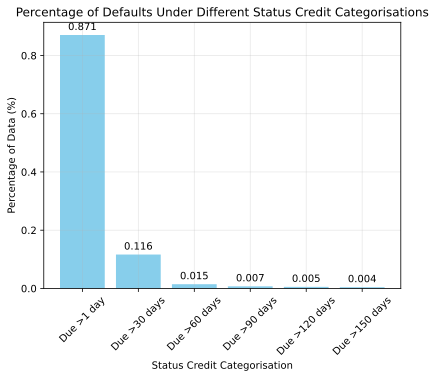

In [ ]:
# plot barchart of percentage of customers who default at different categorisations

label_arr = credit.STATUS.unique()
label_arr.sort() # sorts from 0 to X
label_arr = list(label_arr[:-2]) # remove the paid off and no loans from labels to test

pct_lst = []

while label_arr != []:
    df = credit.copy()
    df['new'] = df['STATUS'].apply(lambda x: 1 if x in label_arr else 0)
    sumagg = df.groupby('ID')['new'].agg(sum)

    df2 = pd.merge(pivot_tb, sumagg, on = 'ID', how = 'left') # filters out repeated status
    df2.loc[df2['new'] > 1, 'new'] = 1
    pct_lst.append(df2['new'].sum() / len(df2))
    label_arr.pop(0)


pct_df = pd.DataFrame({'situation':['Due >1 day',
                               'Due >30 days',
                               'Due >60 days',
                               'Due >90 days',
                               'Due >120 days',
                               'Due >150 days'],
                      'bad customer ratio': pct_lst})


plt.bar(pct_df.situation, pct_df['bad customer ratio'], color='skyblue')

plt.ylabel('Percentage of Data (%)')
plt.xlabel('Status Credit Categorisation')
plt.title('Percentage of Defaults Under Different Status Credit Categorisations')
plt.xticks(rotation=45)
plt.grid(alpha=0.3)
for i, value in enumerate(pct_df['bad customer ratio']):
    plt.text(i, value + 0.01, str(round(value, 3)), ha='center', va='bottom')

An initial analysis shows that 87.1% of customers had at least one late payment by at least a day. However, it's unlikely that such a large proportion of customers should be classified as having bad credit, as many may have simply just forgotten to pay their credit card debts. This is further supported by a 75.5 percentage point drop when excluding customers with delinquencies of less than 30 days.

Still, the remaining 11.6% delinquency rate appears excessively high when compared to historical norms—Federal Reserve Economic Data (FRED) reports an average credit card delinquency rate of approximately 2.54% over the past 10 years (Q1 2015 to Q4 2024).

Therefore, defining “bad credit” as having delinquencies of more than 60 days (label: `['2', '3', '4', '5']`) is a more reasonable and data-aligned approach, as it more closely reflects the long-term FRED benchmark. We will thus be using this definition of 'bad credit' for the rest of this EDA.

### **2.1.4: Observation window testing**

The observation window which represents the number of months the account was active for, plays a crucial role in ensuring that the dataset used for credit risk modeling captures meaningful borrower behavior while minimizing noise from accounts with insufficient history. If the window is too short, the model may lack sufficient data to detect risk patterns. We first attempt to look at the distribution of the number of accounts at each observation window.

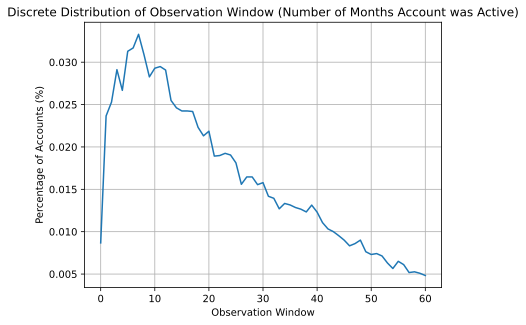

In [ ]:
# Distribution of accounts based on how long their account was active for (observation window)
window_test_df = pivot_tb.groupby('window')['window'].apply(lambda x: len(x)/len(pivot_tb))

plt.plot(window_test_df)
plt.ylabel('Percentage of Accounts (%)')
plt.xlabel('Observation Window')
plt.title('Discrete Distribution of Observation Window (Number of Months Account was Active)')
plt.grid()

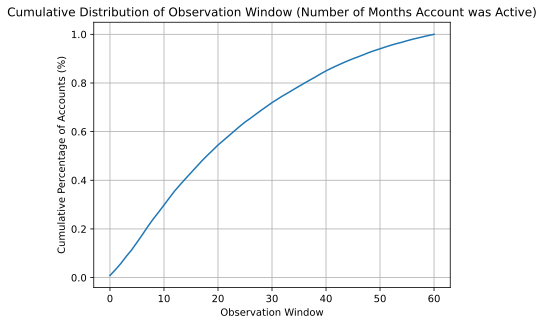

In [ ]:
# Cumulative Distribution of observation window
cum_window_test_df = window_test_df.reset_index(name='percentage')
cum_window_test_df.sort_values('window', inplace=True)
cum_window_test_df['cum_percentage'] = cum_window_test_df['percentage'].cumsum()
cum_window_test_df.set_index('window', inplace=True)

# plt.plot(x=cum_window_test_df['window'], y=cum_window_test_df['cum_percentage'])
plt.plot(cum_window_test_df['cum_percentage'])
plt.ylabel('Cumulative Percentage of Accounts (%)')
plt.xlabel('Observation Window')
plt.title('Cumulative Distribution of Observation Window (Number of Months Account was Active)')
plt.grid()

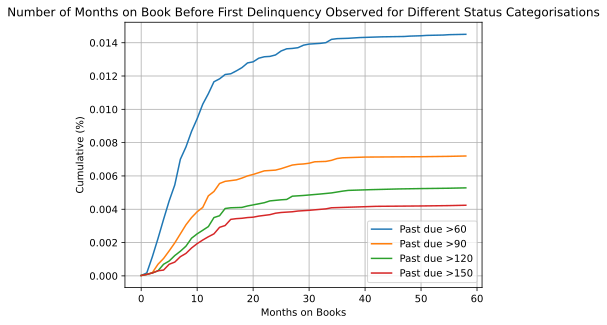

In [ ]:
# find the cumulative percentage of bad customers for each Status Categorisation over the time that it was on book
label_arr = df.STATUS.unique()
label_arr.sort() # sorts from 0 to X
label_arr = list(label_arr[:-2]) # remove the paid off and no loans from labels to test
label_arr = label_arr[2:] # exclude the >1 day customers
pct_lst = []
label_title = ['60', '90', '120', '150']

while label_arr != []:

    df = credit.copy()
    df['new'] = df['STATUS'].apply(lambda x: 1 if x in label_arr else 0)
    df['month_on_book'] = df['MONTHS_BALANCE'] - df['open_month']
    minagg = df[df['new'] == 1].groupby('ID')['month_on_book'].min() # first month a delinquency was observed for each ID
    minagg = pd.DataFrame(minagg)
    minagg['ID'] = minagg.index

    # get percentage of customers who first defaulted in month X
    pct_df = minagg.groupby('month_on_book')['month_on_book'].apply(lambda x: len(x)/len(set(pivot_tb['ID'])))
    label_arr.pop(0)

    # get the cumulative percentage
    cum_pct_df = pct_df.reset_index(name='percentage')
    cum_pct_df.sort_values('month_on_book', inplace=True)
    cum_pct_df['cum_percentage'] = cum_pct_df['percentage'].cumsum()
    cum_pct_df.set_index('month_on_book', inplace=True)
    plt.plot(cum_pct_df['cum_percentage'], label= f'Past due >{label_title.pop(0)}')


plt.grid()
plt.title('Number of Months on Book Before First Delinquency Observed for Different Status Categorisations')
plt.xlabel('Months on Books')
plt.ylabel('Cumulative (%)')
plt.legend()
# minagg


In the previous section, we concluded that customers with delinquencies greater than 60 days (labels: `['2', '3', '4', '5']`) will be categorized as having bad credit. As such, we exclude delinquency statuses of over 1 day and over 30 days, as these categories are significantly larger in volume, and significantly skews the graphs making it difficult to interpret cumulative delinquency patterns.

From the graph, we observe that the cumulative percentage of bad credit begins to plateau around the 15-month mark. This indicates that credit risk within the first 15 months of account activity may be either too premature to assess reliably or too volatile for consistent classification. In the following section, we will assess the impact of filtering out accounts with less than 15 months on book to evaluate the appropriateness of using a 15-month observation window.

Text(15, 0.7677884092638905, '0.618')

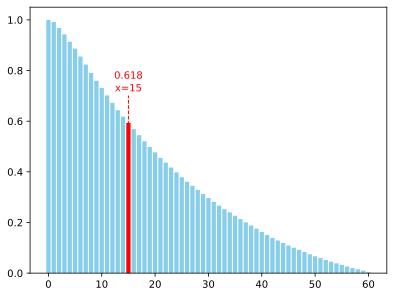

In [ ]:
# find number of customers remaining if we filter out all data with <15 months on book

df = credit.copy()
df['month_on_book'] = df['MONTHS_BALANCE'] - df['open_month']

month_on_book_lst = df['month_on_book'].unique()
month_on_book_lst.sort()
month_on_book_lst

tmp_lst = []
for i in month_on_book_lst:
    num_clients = df[df['month_on_book'] >= i].groupby('ID')['month_on_book'].min() # gets proportion of clients for month on book (window)
    tmp_lst.append( len(num_clients)/len(set(pivot_tb['ID'])))


tmp_df = pd.DataFrame(tmp_lst, index=month_on_book_lst, columns=['Proportion of Data'])

# plot the chart
colors = ['red' if xi == 15 else 'skyblue' for xi in tmp_df.index]

plt.bar(tmp_df.index, tmp_df['Proportion of Data'], color=colors)
plt.axvline(x=15, color='red', linestyle='--', linewidth=1, ymax = tmp_df['Proportion of Data'][14] + 0.05)
plt.text(15, tmp_df['Proportion of Data'][14] + 0.1, 'x=15', color='red', ha='center')
plt.text(15, tmp_df['Proportion of Data'][14] + 0.15, round(tmp_df['Proportion of Data'][14], 3), color='red', ha='center')



This chart shows that <u>61.8% of the data is retained</u> after eliminating accounts with fewer than 15 months on book. By applying this filter, we not only preserve a significant portion of the dataset but also improve data quality by reducing short-term noise and variance.

We can therefore conclude that a **minimum observation window of 15 months** is appropriate for distinguishing between good and bad credit.

### **2.1.5: Vintage Analysis**

After defining what constitutes ‘bad credit’ and establishing the minimum observation window, we proceed to conduct vintage analysis to identify potential seasonality or patterns in the origination months of accounts. This allows us to assess whether certain periods—potentially influenced by temporal economic conditions such as recessions—are associated with higher delinquency rates. Additionally, vintage analysis provides insight into how customer credit behaviour evolves over time, helping to uncover cohort-based risk trends.

In [ ]:
obs_window = 15
bad_credit_lab = ['2', '3', '4', '5']

df = credit.copy()
df = df[df['window'] >= obs_window] # remove users whose observe window less than 15 (<15 months active)
df['bad_credit'] = df['STATUS'].apply(lambda x: 1 if x in bad_credit_lab else 0) # 1: bad credit and overdue, 0: good credit or not overdue

df['month_on_book'] = df['MONTHS_BALANCE'] - df['open_month'] # calculate month on book: number of months the account has been open for
# df.sort_values(by = ['ID','month_on_book'], inplace = True)


bad_df = df[df['bad_credit'] == 1].copy()
bad_df = bad_df.sort_values(by=['open_month', 'ID', 'month_on_book']) # Sort by open_month, ID, and month_on_book to get first occurrence
first_bad_per_id = bad_df.drop_duplicates(subset=['open_month', 'ID']) # Drop duplicate IDs per open_month to count each ID only once

# count unique bad_credit IDs per open_month and month_on_book
bad_counts = first_bad_per_id.groupby(['open_month', 'month_on_book'])['ID'].nunique().reset_index(name='bad_unique_count')
total_ids = pivot_tb.groupby(['open_month'])['ID'].count().reset_index(name='total_unique_ids') # total number of unique IDs per open_month


merged = bad_counts.merge(total_ids, on='open_month', how='left')
merged = merged.sort_values(by=['open_month', 'month_on_book'])

merged['cumulative_bad'] = merged.groupby('open_month')['bad_unique_count'].cumsum()
merged['cumulative_bad_pct'] = (merged['cumulative_bad'] / merged['total_unique_ids'])
# merged['cumulative_bad_pct'] = merged['cumulative_bad_pct'].round(2)

merged.head()

,open_month,month_on_book,bad_unique_count,total_unique_ids,cumulative_bad,cumulative_bad_pct
0,0,5,1,415,1,0.002410
1,0,7,2,415,3,0.007229
2,0,9,1,415,4,0.009639
3,0,11,1,415,5,0.012048
4,0,12,1,415,6,0.014458


Text(0, 0.5, 'Number of Delinquencies')

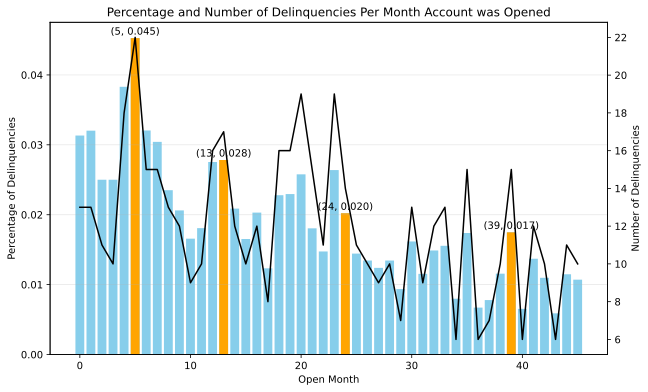

In [ ]:
# Observe which month has the highest rate of delinquency (per month?)
max_delinquency_open_month = merged.groupby('open_month')['cumulative_bad_pct'].max()
# plt.bar(max_delinquency_open_month.index, height=max_delinquency_open_month, color='skyblue')

# get local peaks every 12 months
peaks = []
window_size = 12
for i in range(0, len(max_delinquency_open_month), window_size):
    window = max_delinquency_open_month.iloc[i:i + window_size]
    if not window.empty:
        local_max_idx = window.idxmax()
        peaks.append(local_max_idx)


fig, ax1 = plt.subplots(figsize=(10, 6))

bars = ax1.bar(max_delinquency_open_month.index, max_delinquency_open_month.values, color='skyblue')

# highlight and label the peaks
for idx in peaks:
    ax1.bar(idx, max_delinquency_open_month.loc[idx], color='orange')  # highlight bars
    ax1.text(idx, max_delinquency_open_month.loc[idx] + 0.0005, f"({idx}, {max_delinquency_open_month.loc[idx]:.3f})", ha='center', color='black')

ax1.set_xlabel('Open Month')
ax1.set_ylabel('Percentage of Delinquencies')
ax1.set_title('Percentage and Number of Delinquencies Per Month Account was Opened')
ax1.grid(True, axis='y', alpha=0.3)

ax2 = ax1.twinx()

merged

ax2.plot(merged.groupby('open_month')['cumulative_bad'].max(), color='black', label='Line Data')
# ax2.plot(merged.groupby('open_month')['total_unique_ids'].max(), color='black', label='Line Data')
ax2.set_ylabel('Number of Delinquencies')


The presence of local peaks at regular intervals suggests potential seasonality in the month of credit account origination, suggesting that there might be cohort-based risk trends present. Additionally, the overall downward trend in delinquency percentages across opening months can be attributed to two key factors: an increase in the total number of accounts opened and a decline in the absolute number of delinquencies. This indicates a possible improvement in customer creditworthiness or tighter credit approval standards over time.

In [ ]:
# Find the specific MONTHS_BALANCE balance in which the default rate is the highest by plotting defaults against MONTHS_BALANCE

bad_df = df[df['bad_credit'] == 1].copy()
bad_df = bad_df.sort_values(by=['MONTHS_BALANCE', 'ID']) # Sort by open_month, ID, and month_on_book to get first occurrence
first_bad_per_id = bad_df.drop_duplicates(subset=['ID']) # Drop duplicate IDs per open_month to count each ID only once

# count unique bad_credit IDs per open_month and month_on_book
bad_counts = first_bad_per_id.groupby(['MONTHS_BALANCE'])['ID'].nunique().reset_index(name='bad_unique_count')
total_ids = credit.groupby(['MONTHS_BALANCE'])['ID'].nunique().reset_index(name='total_unique_ids') # total number of unique IDs per open_month


merged = bad_counts.merge(total_ids, on='MONTHS_BALANCE', how='left')
merged = merged.sort_values(by=['MONTHS_BALANCE'])

merged['cumulative_bad'] = merged.groupby('MONTHS_BALANCE')['bad_unique_count'].cumsum()
merged['cumulative_bad_pct'] = (merged['cumulative_bad'] / merged['total_unique_ids'])
# merged['cumulative_bad_pct'] = merged['cumulative_bad_pct'].round(2)


merged.head()

,MONTHS_BALANCE,bad_unique_count,total_unique_ids,cumulative_bad,cumulative_bad_pct
0,4,2,2109,2,0.000948
1,5,1,2578,1,0.000388
2,6,2,3028,2,0.000661
3,7,5,3498,5,0.001429
4,8,6,4025,6,0.001491


Text(0, 0.5, 'Number of Delinquencies')

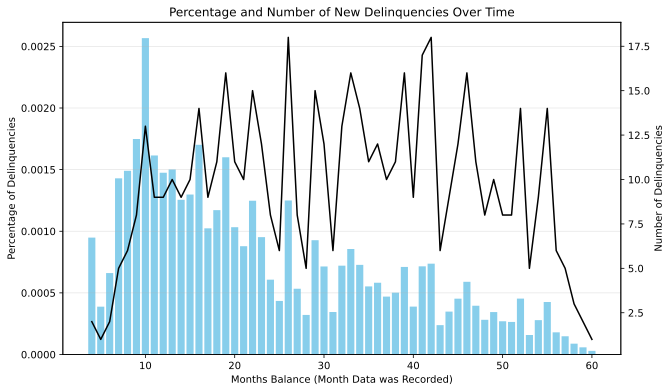

In [ ]:
fig, ax1 = plt.subplots(figsize=(10, 6))

ax1.bar(merged['MONTHS_BALANCE'], merged.cumulative_bad_pct, color='skyblue')
ax1.set_xlabel('Months Balance (Month Data was Recorded)')
ax1.set_ylabel('Percentage of Delinquencies')
ax1.set_title('Percentage and Number of New Delinquencies Over Time')
ax1.grid(True, axis='y', alpha=0.3)

ax2 = ax1.twinx()
ax2.plot(merged[['MONTHS_BALANCE', 'cumulative_bad']].set_index('MONTHS_BALANCE'), color='black')
ax2.set_ylabel('Number of Delinquencies')

A decreasing trend in the percentage of new delinquencies is observed over time. However, the absolute number of new delinquencies remains relatively stable, generally ranging between 5 to 15 per month. This suggests that the decline in delinquency rates is primarily driven by an increase in the number of good-credit clients, rather than a reduction in the number of delinquent cases. As such, there appears to be no conclusive evidence of seasonality in credit card delinquencies over time based on the available data.

## **2.2: Applications Dataset**

Fill this part up

In [ ]:
print(f"Number of unique IDs application records: {len(set(application['ID']))}")
print(f"Number of unique IDs in credit record: {len(set(credit['ID']))}")
print(f"Number of IDs the 2 tables share in common: {len(set(application['ID']).intersection(set(credit['ID'])))}")

Number of unique IDs application records: 438510
Number of unique IDs in credit record: 45985
Number of IDs the 2 tables share in common: 36457


### **2.2.1: Feature Engineering**

In [ ]:
# Feature Engineering
application["AGE"] = (-application["DAYS_BIRTH"]) // 365
application["YEARS_EMPLOYED"] = application["DAYS_EMPLOYED"].apply(lambda x: 0 if x >= 365243 else -x // 365)
application["income_per_family_member"] = application["AMT_INCOME_TOTAL"] / application["CNT_FAM_MEMBERS"]
application["employment_age_ratio"] = (application["YEARS_EMPLOYED"] / application["AGE"]).replace([np.inf, -np.inf], 0).fillna(0)
application["married"] = (application["CNT_FAM_MEMBERS"] - application["CNT_CHILDREN"] - 1 == 1).astype(int)
application.drop(columns=["NAME_FAMILY_STATUS", "CNT_FAM_MEMBERS", "CNT_CHILDREN"], inplace=True)


### **2.2.2: Credit Score Distribution**

- The majority of users possess **credit scores ranging from 0.6 to 1.0**, indicating **minimal or no instances of delinquency**.  
- The exponential scoring methodology significantly penalizes even a small number of overdue payments.  
- A minor proportion of users exhibit credit scores below 0.4, suggesting the presence of **higher-risk borrowers**.

These observations confirm that the data distribution is **right-skewed**, with the majority of users demonstrating financial responsibility—**a trend consistent with real-world patterns**.

In [ ]:
credit_numeric = credit[credit["STATUS"].isin(["0", "1", "2", "3", "4", "5"])].copy()
credit_numeric["STATUS"] = credit_numeric["STATUS"].astype(int)

credit_numeric['credit_score'] = credit_numeric['STATUS'].apply(lambda x: math.e**(-x))
mean_exp_status = credit_numeric.groupby('ID')['credit_score'].mean().reset_index()
months = credit_numeric.groupby('ID').count()['MONTHS_BALANCE'].reset_index()

score_distribution = mean_exp_status['credit_score'].describe()
score_distribution

,credit_score
count,40032.000000
mean,0.980281
std,0.074637
min,0.006738
25%,1.000000
50%,1.000000
75%,1.000000
max,1.000000


In [ ]:
merged_df = pd.merge(application, mean_exp_status, on="ID", how="inner")
merged_df = pd.merge(merged_df, months, on="ID", how="inner")

In [ ]:
df_with_fam = merged_df.copy()
df_with_fam["OCCUPATION_TYPE"] = df_with_fam["OCCUPATION_TYPE"].fillna("Unknown")

binary_cols = ["CODE_GENDER", "FLAG_OWN_CAR", "FLAG_OWN_REALTY", "married"]
le = LabelEncoder()
for col in binary_cols:
    df_with_fam[col] = le.fit_transform(df_with_fam[col])

multi_cols_excl_family = [
    "NAME_INCOME_TYPE", "NAME_EDUCATION_TYPE",
    "NAME_HOUSING_TYPE", "OCCUPATION_TYPE"
]
df_with_fam = pd.get_dummies(df_with_fam, columns=multi_cols_excl_family)

X = df_with_fam.drop(columns=["ID", "credit_score"])
y = df_with_fam["credit_score"]

KeyError: 'married'

In [ ]:
X_df = pd.DataFrame(X, columns=X.columns)
processed_df = X_df.copy()
processed_df["credit_score"] = y.reset_index(drop=True)
processed_df

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,AGE,YEARS_EMPLOYED,income_per_family_member,employment_age_ratio,married,MONTHS_BALANCE,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Unknown,OCCUPATION_TYPE_Waiters/barmen staff,credit_score
0,1,1,1,427500.0,-12005,-4542,1,1,0,0,32,12,213750.0,0.375000,1,2,False,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,0.683940
1,1,1,1,427500.0,-12005,-4542,1,1,0,0,32,12,213750.0,0.375000,1,2,False,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,0.683940
2,1,1,1,112500.0,-21474,-1134,1,0,0,0,58,3,56250.0,0.051724,1,7,False,False,False,False,True,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,1.000000
3,0,0,1,270000.0,-19110,-3051,1,0,1,1,52,8,270000.0,0.153846,0,2,True,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,1.000000
4,0,0,1,270000.0,-19110,-3051,1,0,1,1,52,8,270000.0,0.153846,0,6,True,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31997,1,1,1,315000.0,-17348,-2420,1,0,0,0,47,6,157500.0,0.127660,1,4,False,False,False,False,True,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,0.009632
31998,0,0,1,157500.0,-12387,-1325,1,0,1,1,33,3,78750.0,0.090909,1,19,True,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,0.208479
31999,0,0,1,157500.0,-12387,-1325,1,0,1,1,33,3,78750.0,0.090909,1,19,False,True,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,0.208479
32000,0,0,1,283500.0,-17958,-655,1,0,0,0,49,1,141750.0,0.020408,1,10,False,False,False,False,True,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,Fal

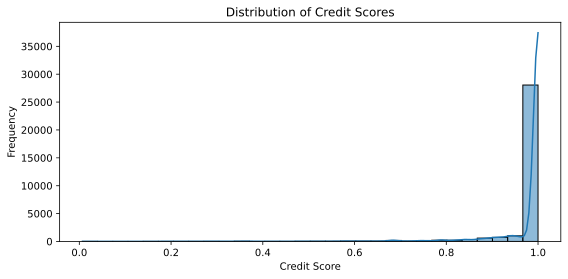

In [ ]:
plt.figure(figsize=(8, 4))
sns.histplot(merged_df["credit_score"], bins=30, kde=True) ## merged_df only created in the next segment
plt.title("Distribution of Credit Scores")
plt.xlabel("Credit Score")
plt.ylabel("Frequency")
plt.tight_layout()
plt.show()

### **2.2.3: Outlier Detection**

**Observations:**
- **Income** (`AMT_INCOME_TOTAL`):
  - The majority of values fall within the range of **100,000 to 300,000**.
  - A small number of extreme outliers exceed **1,000,000**, which may represent high-income individuals or potential data noise.

**Recommendation:**  
For those involved in model development, it is advisable to **cap** or **flag** these extreme values during subsequent training phases, or consider applying **robust scaling techniques** to mitigate their influence.


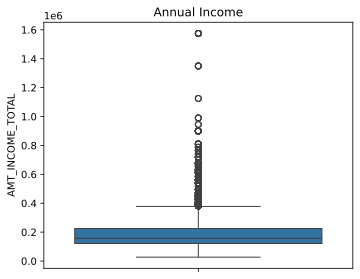

In [ ]:
plt.figure(figsize=(14, 4))

plt.subplot(1, 3, 1)
sns.boxplot(y=merged_df["AMT_INCOME_TOTAL"])
plt.title("Annual Income")

plt.tight_layout()
plt.show()

### **2.2.4: Categorical Feature Distributions**

Below are key insights derived from the distribution of each categorical variable:

**Education Level**  
- The majority of applicants possess a **Secondary / Secondary Special** level of education.  
- Smaller proportions hold **Higher** or **Academic Degree** qualifications.  
- A minimal number have attained only **Lower Secondary** education, potentially indicating older age groups or limited educational access.

**Income Type**  
- The predominant group is **Working individuals**, followed by **Commercial Associates**, **Pensioners**, and **State Servants**.  
- Less common categories such as **Students** or the **Unemployed** may necessitate special treatment during data preprocessing.

**Occupation Type**  
- Most applicants are categorized as **Sales staff**, **Laborers**, or **Core staff**.  
- Approximately **31%** are labeled as **Unknown** (imputed during data cleaning); given the size of this group, it should be incorporated into analyses with caution.


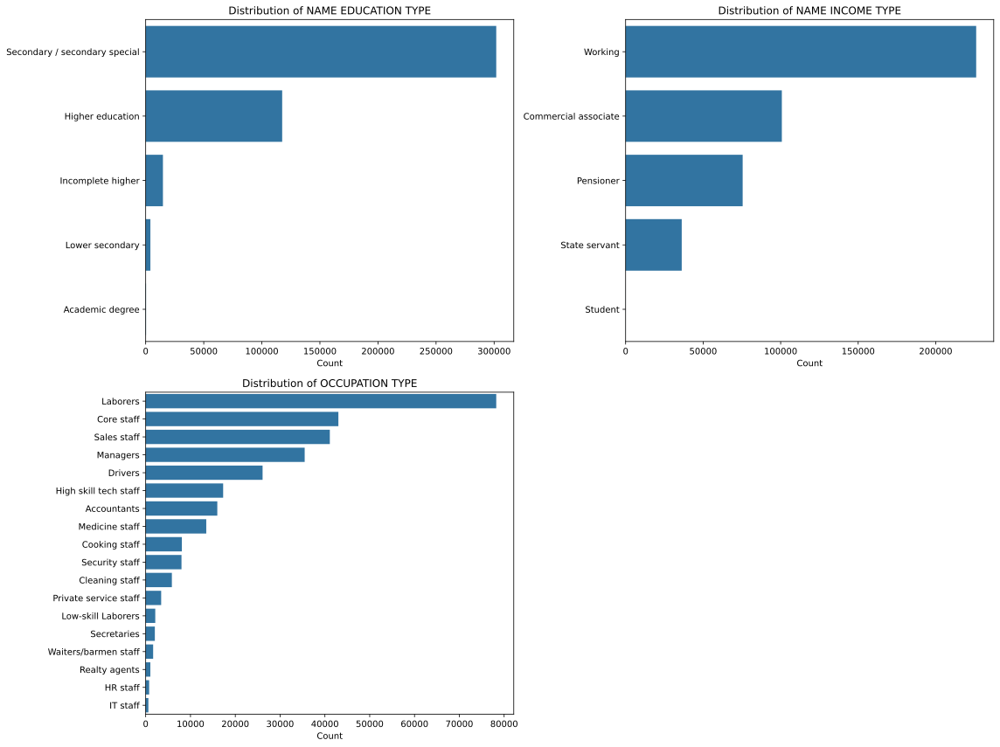

In [ ]:
categorical_cols = ["NAME_EDUCATION_TYPE", "NAME_INCOME_TYPE", "OCCUPATION_TYPE"]

plt.figure(figsize=(16, 12))
for i, col in enumerate(categorical_cols):
    plt.subplot(2, 2, i+1)
    sns.countplot(data=application, y=col, order=application[col].value_counts().index)
    plt.title(f"Distribution of {col.replace('_', ' ')}")
    plt.xlabel("Count")
    plt.ylabel("")

plt.tight_layout()
plt.show()

### **2.2.5: Correlation Insights**

Based on the heatmap analysis, the following relationships have been observed:

**Positive Correlation with Credit Score**  
- `DAYS_EMPLOYED` (r = 0.31): Longer employment duration is associated with higher credit scores.  
- `YEARS_EMPLOYED` and `employment_age_ratio`: These features follow a similar trend and demonstrate moderate positive correlation.  
- `AGE`: Older individuals generally exhibit higher credit scores.

**Weak or Negligible Correlation**  
- `AMT_INCOME_TOTAL`: Displays minimal linear correlation with credit score, suggesting that income alone is not a strong determinant of creditworthiness.


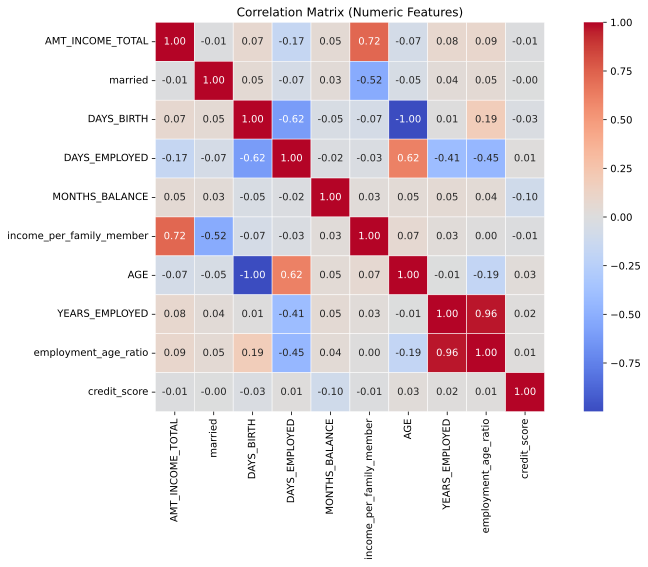

In [ ]:
numeric_cols = [
    "AMT_INCOME_TOTAL", "married",
    "DAYS_BIRTH", "DAYS_EMPLOYED", "MONTHS_BALANCE", "income_per_family_member",
    "AGE", "YEARS_EMPLOYED", "employment_age_ratio",
    "credit_score"
]

corr_matrix = processed_df[numeric_cols].corr()

# Plot heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="coolwarm", square=True, linewidths=0.5)
plt.title("Correlation Matrix (Numeric Features)")
plt.tight_layout()
plt.show()

### **2.2.6: Feature vs. Credit Score Trends**

The following visualizations illustrate how selected continuous variables relate to credit score:

**Age**  
- Credit score generally **increases with age** up to a certain threshold.  
- Older individuals tend to exhibit more stable and responsible credit behavior.

**Years Employed**  
- A clear positive trend is observed: **greater employment duration is associated with higher credit scores**.  
- This supports the notion that employment stability enhances creditworthiness.

**Income & Income Per Family Member**  
- These variables do not demonstrate a strong linear relationship with credit score.  
- This suggests that **income alone is not a reliable indicator of credit behavior**, highlighting the importance of financial habits and history.

**Employment-Age Ratio**  
- A mild upward trend is present, though the data exhibits considerable variability.  
- Extremely high ratios—often representing younger individuals with full-time employment—show a wider spread in credit scores.



In [ ]:
features_to_plot = ["AGE", "YEARS_EMPLOYED", "AMT_INCOME_TOTAL", "employment_age_ratio", "income_per_family_member"]

plt.figure(figsize=(16, 10))
for i, col in enumerate(features_to_plot):
    plt.subplot(2, 3, i+1)
    sns.scatterplot(data=processed_df, x=col, y="credit_score", alpha=0.3)
    plt.title(f"{col.replace('_', ' ').title()} vs Credit Score")
    plt.xlabel(col.replace('_', ' ').title())
    plt.ylabel("Credit Score")

plt.tight_layout()
plt.show()

# **3: Supervised Learning**

### **Model Definitions (Supervised Regression)**

The following supervised regression models will be employed:

- **Linear Regression**: Serves as a baseline model with easily interpretable coefficients.  
- **Lasso Regression**: Incorporates L1 regularization, enabling inherent feature selection.  
- **Decision Tree Regressor**: Capable of modeling non-linear relationships through hierarchical splits.  
- **Random Forest Regressor**: An ensemble method that captures complex feature interactions and provides feature importance metrics.  
- **LightGBM Regressor**: A high-performance gradient boosting model known for speed, accuracy, and its ability to handle missing values effectively.

Model performance will be evaluated using the following metrics:
- **Root Mean Squared Error (RMSE)**
- **Mean Absolute Error (MAE)**
- **R-squared (R²)**

### **Feature Engineering**

The following engineered features have already been incorporated into the dataset:

- `AGE`, `YEARS_EMPLOYED`  
- `income_per_family_member`  
- `employment_age_ratio`  
- `window` (credit history duration)

This enhanced feature set will now be used to apply **feature selection techniques** in preparation for model training.


## 3.1 Data Cleaning & Preprocessing (Supervised) + Feature Selection

### **3.1.1 Input Summary**

- `application_record.csv`: Successfully loaded, containing data for **438,557 applicants**.  
- `credit_record.csv`: Successfully loaded, comprising **1,048,575** monthly credit history entries.



In [ ]:
credit_numeric = credit[credit["STATUS"].isin(["0", "1", "2", "3", "4", "5"])].copy()
credit_numeric["STATUS"] = credit_numeric["STATUS"].astype(int)


credit_numeric['credit_score'] = credit_numeric['STATUS'].apply(lambda x: math.e**(-x))
mean_exp_status = credit_numeric.groupby('ID')['credit_score'].mean().reset_index()
months = credit_numeric.groupby('ID').count()['MONTHS_BALANCE'].reset_index()

score_distribution = mean_exp_status['credit_score'].describe()
score_distribution

,credit_score
count,40032.000000
mean,0.980281
std,0.074637
min,0.006738
25%,1.000000
50%,1.000000
75%,1.000000
max,1.000000


In [ ]:
# max_status = credit_numeric.groupby("ID")["STATUS"].max().reset_index()
# max_status["credit_score"] = (1 - max_status["STATUS"] / 5) * 100
# max_status = max_status[["ID", "credit_score"]]

credit_numeric['credit_score'] = credit_numeric['STATUS'].apply(lambda x: math.e**(-x))
mean_exp_status = credit_numeric.groupby('ID')['credit_score'].mean().reset_index()
months = credit_numeric.groupby('ID').count()['MONTHS_BALANCE'].reset_index()

score_distribution = mean_exp_status['credit_score'].describe()
score_distribution

,credit_score
count,40032.000000
mean,0.980281
std,0.074637
min,0.006738
25%,1.000000
50%,1.000000
75%,1.000000
max,1.000000


### **3.1.2 Credit Scoring with Exponential Decay**

Rather than relying on the maximum `STATUS` value, an alternative credit scoring approach was implemented using the formula:


- This method assigns **higher scores to less severe delinquencies** while **penalizing more serious ones exponentially**.  
- For instance: `STATUS = 0` results in a score of `1`, whereas `STATUS = 5` yields a score of approximately `0.0067`.

The **mean credit score per user** was then calculated to represent their overall creditworthiness.

### **Credit Window**

Additionally, the following metric was computed:

`months = number of months of credit history available`


This provides insight into the **duration of each user’s financial history**, serving as a proxy for credit exposure over time.

In [ ]:
# merged_df = pd.merge(app_df, max_status, on="ID", how="inner")
merged_df = pd.merge(application, mean_exp_status, on="ID", how="inner")
merged_df = pd.merge(merged_df, months, on="ID", how="inner")

### **3.1.3 Merging Datasets**

The computed credit scores and credit history windows were merged back into the applicant dataset.  
Only users with valid and available credit history records were retained for further analysis.

**Result:**  
- Final dataset size: approximately **32,000 users**


In [ ]:
missing_values = merged_df.isnull().sum()
missing_values = missing_values[missing_values > 0].sort_values(ascending=False)
missing_values

,0
OCCUPATION_TYPE,9961


In [ ]:
merged_df["OCCUPATION_TYPE"] = merged_df["OCCUPATION_TYPE"].fillna("Unknown")
missing_after = merged_df.isnull().sum().sum()
missing_after

np.int64(0)

### **3.1.4 Missing Values**

- The `OCCUPATION_TYPE` column contained approximately **30% missing values**.  
- These were imputed with the placeholder **"Unknown"** to facilitate consistent encoding.

**Outcome:**  
- Following this step, **no missing values remain** in the dataset.


In [ ]:
df_with_fam = merged_df.copy()
df_with_fam["OCCUPATION_TYPE"] = df_with_fam["OCCUPATION_TYPE"].fillna("Unknown")

binary_cols = ["CODE_GENDER", "FLAG_OWN_CAR", "FLAG_OWN_REALTY", "married"]
le = LabelEncoder()
for col in binary_cols:
    df_with_fam[col] = le.fit_transform(df_with_fam[col])

multi_cols_excl_family = [
    "NAME_INCOME_TYPE", "NAME_EDUCATION_TYPE",
    "NAME_HOUSING_TYPE", "OCCUPATION_TYPE"
]
df_with_fam = pd.get_dummies(df_with_fam, columns=multi_cols_excl_family)

X = df_with_fam.drop(columns=["ID", "credit_score"])
y = df_with_fam["credit_score"]

In [ ]:
X_df = pd.DataFrame(X, columns=X.columns)
processed_df = X_df.copy()
processed_df["credit_score"] = y.reset_index(drop=True)
processed_df

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,AGE,YEARS_EMPLOYED,income_per_family_member,employment_age_ratio,married,MONTHS_BALANCE,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Unknown,OCCUPATION_TYPE_Waiters/barmen staff,credit_score
0,1,1,1,427500.0,-12005,-4542,1,1,0,0,32,12,213750.0,0.375000,1,2,False,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,0.683940
1,1,1,1,427500.0,-12005,-4542,1,1,0,0,32,12,213750.0,0.375000,1,2,False,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,0.683940
2,1,1,1,112500.0,-21474,-1134,1,0,0,0,58,3,56250.0,0.051724,1,7,False,False,False,False,True,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,1.000000
3,0,0,1,270000.0,-19110,-3051,1,0,1,1,52,8,270000.0,0.153846,0,2,True,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,1.000000
4,0,0,1,270000.0,-19110,-3051,1,0,1,1,52,8,270000.0,0.153846,0,6,True,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31997,1,1,1,315000.0,-17348,-2420,1,0,0,0,47,6,157500.0,0.127660,1,4,False,False,False,False,True,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,0.009632
31998,0,0,1,157500.0,-12387,-1325,1,0,1,1,33,3,78750.0,0.090909,1,19,True,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,0.208479
31999,0,0,1,157500.0,-12387,-1325,1,0,1,1,33,3,78750.0,0.090909,1,19,False,True,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,0.208479
32000,0,0,1,283500.0,-17958,-655,1,0,0,0,49,1,141750.0,0.020408,1,10,False,False,False,False,True,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,Fal

### **3.1.5 Final Output**

- `X`: Contains all engineered and encoded features.  
- `y`: Represents the target variable, `credit_score`.  
- The final DataFrame comprises the `credit_score` and **52 feature columns**, and is fully prepared for modeling.


In [ ]:
correlations = pd.DataFrame(X.corrwith(y), columns=["Correlation"]).sort_values(by="Correlation", ascending=False)
correlations

/usr/local/lib/python3.11/dist-packages/numpy/lib/_function_base_impl.py:2922: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/usr/local/lib/python3.11/dist-packages/numpy/lib/_function_base_impl.py:2923: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


,Correlation
FLAG_OWN_REALTY,0.030869
AGE,0.029799
NAME_EDUCATION_TYPE_Secondary / secondary special,0.018183
OCCUPATION_TYPE_Unknown,0.016469
YEARS_EMPLOYED,0.015023
DAYS_EMPLOYED,0.014727
NAME_HOUSING_TYPE_House / apartment,0.013418
OCCUPATION_TYPE_Private service staff,0.012944
NAME_INCOME_TYPE_Working,0.011660
employment_age_ratio,0.011346


### **3.1.6 Correlation-Based Feature Ranking**

The **Pearson correlation coefficient** was computed between each feature and the target variable, `credit_score`.

**Note:**  
- All correlations observed were relatively weak.  
- This is expected in real-world credit scoring contexts, where **non-linear relationships and complex feature interactions** often play a more significant role than simple linear associations.


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
imputer = SimpleImputer(strategy="mean")
X_train = pd.DataFrame(imputer.fit_transform(X_train), columns=X.columns)
X_test = pd.DataFrame(imputer.transform(X_test), columns=X.columns)

In [ ]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [ ]:
lasso = LassoCV(cv=5, random_state=42, max_iter=10000)
lasso.fit(X_train_scaled, y_train)

LassoCV(cv=5, max_iter=10000, random_state=42)

In [ ]:
model = SelectFromModel(lasso, prefit=True)
selected_features_lasso = X.columns[model.get_support()].tolist()

In [ ]:
selected_features_lasso

['CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'AMT_INCOME_TOTAL',
 'DAYS_EMPLOYED',
 'FLAG_WORK_PHONE',
 'FLAG_PHONE',
 'FLAG_EMAIL',
 'AGE',
 'YEARS_EMPLOYED',
 'income_per_family_member',
 'employment_age_ratio',
 'MONTHS_BALANCE',
 'NAME_INCOME_TYPE_Commercial associate',
 'NAME_INCOME_TYPE_Pensioner',
 'NAME_INCOME_TYPE_State servant',
 'NAME_INCOME_TYPE_Student',
 'NAME_INCOME_TYPE_Working',
 'NAME_EDUCATION_TYPE_Academic degree',
 'NAME_EDUCATION_TYPE_Incomplete higher',
 'NAME_EDUCATION_TYPE_Lower secondary',
 'NAME_EDUCATION_TYPE_Secondary / secondary special',
 'NAME_HOUSING_TYPE_Co-op apartment',
 'NAME_HOUSING_TYPE_Municipal apartment',
 'NAME_HOUSING_TYPE_Office apartment',
 'NAME_HOUSING_TYPE_Rented apartment',
 'NAME_HOUSING_TYPE_With parents',
 'OCCUPATION_TYPE_Accountants',
 'OCCUPATION_TYPE_Cleaning staff',
 'OCCUPATION_TYPE_Cooking staff',
 'OCCUPATION_TYPE_Core staff',
 'OCCUPATION_TYPE_Drivers',
 'OCCUPATION_TYPE_HR staff',
 'OCCUPATION_TYPE_IT staff',
 'OCC



```
# This is formatted as code
```

### **3.1.7 Final Selected Features (Lasso Regression)**

The following features were identified by the **Lasso regression model** as most predictive of `credit_score`:

**Basic Demographics & Income**  
- `FLAG_OWN_CAR`, `FLAG_OWN_REALTY`  
- `AMT_INCOME_TOTAL`, `DAYS_BIRTH`, `MONTHS_BALANCE` (proxy for credit history length)

**Income Types**  
- `NAME_INCOME_TYPE_Commercial associate`  
- `NAME_INCOME_TYPE_State servant`  
- `NAME_INCOME_TYPE_Student`

**Education**  
- `NAME_EDUCATION_TYPE_Incomplete higher`  
- `NAME_EDUCATION_TYPE_Secondary / secondary special`

**Housing**  
- `NAME_HOUSING_TYPE_House / apartment`  
- `NAME_HOUSING_TYPE_Office apartment`  
- `NAME_HOUSING_TYPE_Rented apartment`

**Occupation**  
- A diverse set of roles including:  
  `Accountants`, `Cleaning staff`, `Cooking staff`, `Core staff`,  
  `Drivers`, `IT staff`, `Low-skill Laborers`, `Managers`,  
  `Medicine staff`, `Sales staff`, `Secretaries`, and `Unknown`

In [ ]:
lasso_coef = pd.Series(lasso.coef_, index=X.columns)
non_zero_coef = lasso_coef[lasso_coef != 0].sort_values(key=abs, ascending=False)

<ipython-input-43-3284ef313fe8>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=non_zero_coef.values, y=non_zero_coef.index, palette="coolwarm")


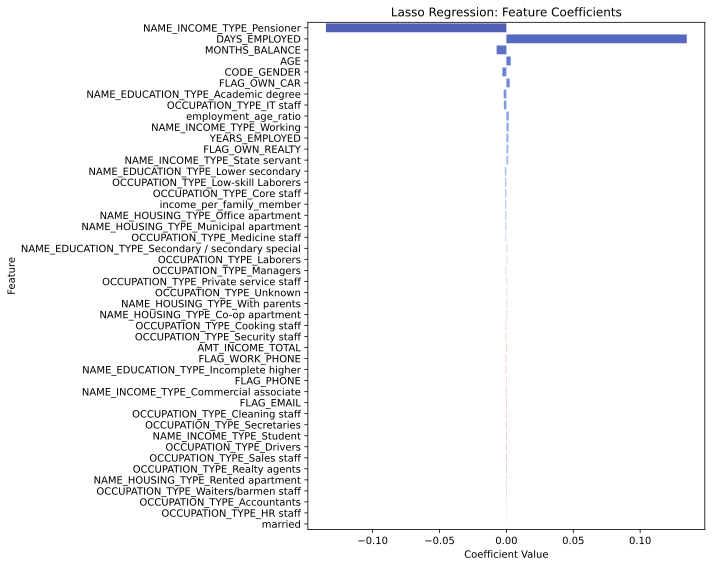

In [ ]:
plt.figure(figsize=(10, 8))
sns.barplot(x=non_zero_coef.values, y=non_zero_coef.index, palette="coolwarm")
plt.title("Lasso Regression: Feature Coefficients")
plt.xlabel("Coefficient Value")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()

<ipython-input-44-00f6a160abf6>:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=non_zero_coef_no_occ.values, y=non_zero_coef_no_occ.index, palette="coolwarm")


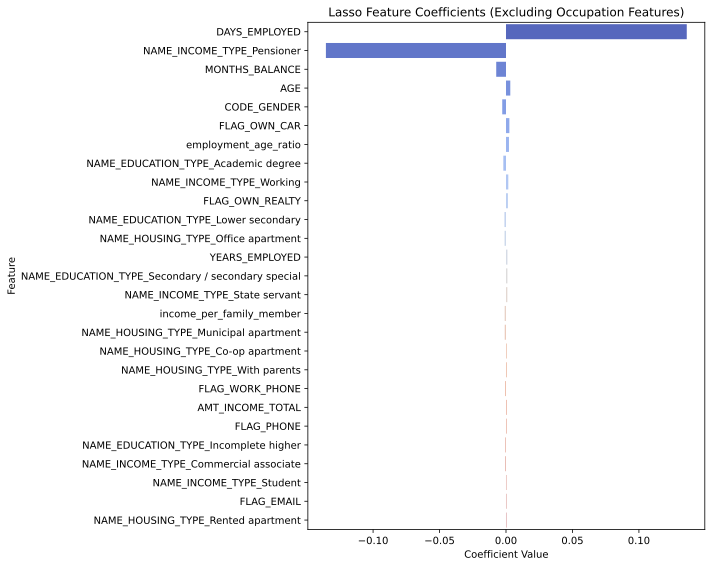

In [ ]:
# WITHOUT OCCUPATION
occupation_cols = [col for col in X.columns if col.startswith("OCCUPATION_TYPE")]
X_no_occupation = X.drop(columns=occupation_cols)

from sklearn.model_selection import train_test_split
X_train_no_occ, X_test_no_occ, y_train_no_occ, y_test_no_occ = train_test_split(
    X_no_occupation, y, test_size=0.2, random_state=42)

imputer = SimpleImputer(strategy="mean")
X_train_no_occ_imp = pd.DataFrame(imputer.fit_transform(X_train_no_occ), columns=X_no_occupation.columns)
X_test_no_occ_imp = pd.DataFrame(imputer.transform(X_test_no_occ), columns=X_no_occupation.columns)

scaler = StandardScaler()
X_train_no_occ_scaled = scaler.fit_transform(X_train_no_occ_imp)
X_test_no_occ_scaled = scaler.transform(X_test_no_occ_imp)

lasso_no_occ = LassoCV(cv=5, random_state=42, max_iter=10000)
lasso_no_occ.fit(X_train_no_occ_scaled, y_train_no_occ)

lasso_coef_no_occ = pd.Series(lasso_no_occ.coef_, index=X_no_occupation.columns)
non_zero_coef_no_occ = lasso_coef_no_occ[lasso_coef_no_occ != 0].sort_values(key=abs, ascending=False)

plt.figure(figsize=(10, 8))
sns.barplot(x=non_zero_coef_no_occ.values, y=non_zero_coef_no_occ.index, palette="coolwarm")
plt.title("Lasso Feature Coefficients (Excluding Occupation Features)")
plt.xlabel("Coefficient Value")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()

- **Occupation-related features contribute meaningful predictive signal**, but the models remain functional even in their absence.  
- This is particularly useful in scenarios where occupation data may be **missing or considered unreliable**.

In [ ]:
y_pred_with_occ = lasso.predict(X_test_scaled)
y_pred_no_occ = lasso_no_occ.predict(X_test_no_occ_scaled)

r2_with_occ = r2_score(y_test, y_pred_with_occ)
r2_no_occ = r2_score(y_test_no_occ, y_pred_no_occ)

r2_with_occ, r2_no_occ

(0.027522248135448235, 0.026814245200584952)

- Incorporating occupation-related features results in a **slightly improved R² score** (approximately a 0.001 gain).  
- This indicates that occupation contributes **some predictive value**, though it is **not essential** to model performance.  
- Overall, R² scores remain low, which is expected in credit scoring tasks when using linear models, as the underlying data relationships are likely **nonlinear** in nature.

In [ ]:
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

RandomForestRegressor(random_state=42)

In [ ]:
rf_importances = pd.Series(rf.feature_importances_, index=X.columns)
top_rf_features = rf_importances.sort_values(ascending=False).head(30)

<ipython-input-48-8ef1f249e62f>:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_rf_features.values, y=top_rf_features.index, palette="viridis")


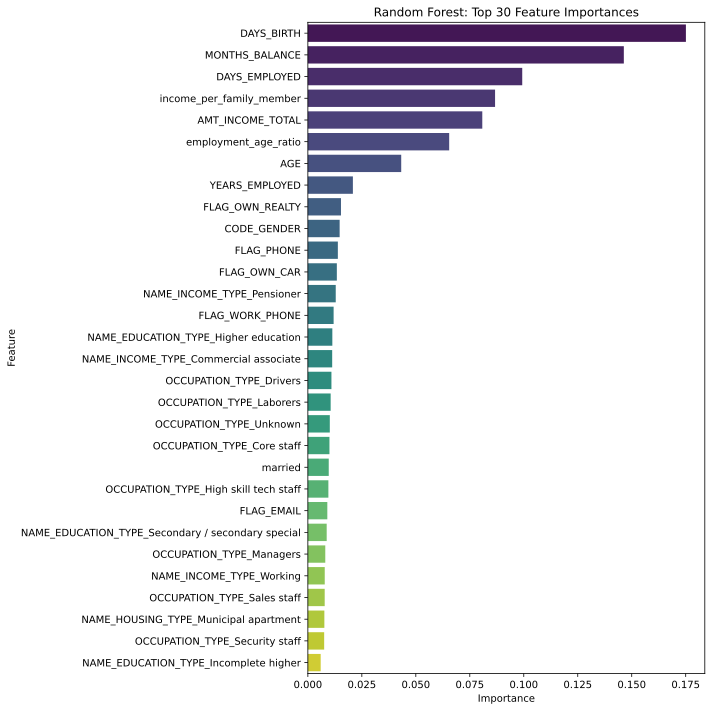

In [ ]:
plt.figure(figsize=(10, 10))
sns.barplot(x=top_rf_features.values, y=top_rf_features.index, palette="viridis")
plt.title("Random Forest: Top 30 Feature Importances")
plt.xlabel("Importance")
plt.ylabel("Feature")
plt.tight_layout()
plt.show()

### **3.1.8 Key Observations and Rationale**

- A **longer credit history** provides more data points, enabling more reliable risk assessment.
- **Older applicants** tend to demonstrate more financially responsible behavior.
- **Years of employment** is a strong indicator of stability and long-term reliability.
- **Income** contributes meaningfully to predictions, although it is not a decisive factor on its own.
- **Larger families** may imply higher levels of responsibility, but also introduce greater financial pressure.

### **Model Agreement on Key Predictive Features**

Both **Lasso** and **Random Forest** models consistently identified the following features as important:

- **Income**  
- **Age** (represented by `DAYS_BIRTH`)  
- **Credit history length** (`window`)  
- **Family, marital, and housing context**

### **Rationale for Dropping Certain Features**

- **Occupation-related columns**:  
  There are numerous occupation categories, but much of the underlying economic profile is already captured through income and employment duration.  
- **Family-related columns**:  
  Marital status, when treated as a binary variable (e.g., married vs. not married), effectively summarizes family situation for modeling purposes.

**Note on Data Quality:**  
- There are **8 outliers** with invalid marriage values (e.g., `-1`, `-2`). These can be safely removed from the dataset.

### 3.1.9 Smogn for the imbalance issue

In [ ]:
data_smogn = smogn.smoter(
    data=df_with_fam,
    y="credit_score",  # Specify the target column
    k=2,         # Number of nearest neighbors
)

To handle the imbalance issue, we applied smogn to the dataset. Synthetic Minority Over-Sampling Technique for Regression with Gaussian Noise is a Python-based implementation designed to address imbalanced regression problems. According to the test results on the LightGBM model as follows, the model performance with smogn data sees a distinct improvement in all RMSE, MAE, and R² scores

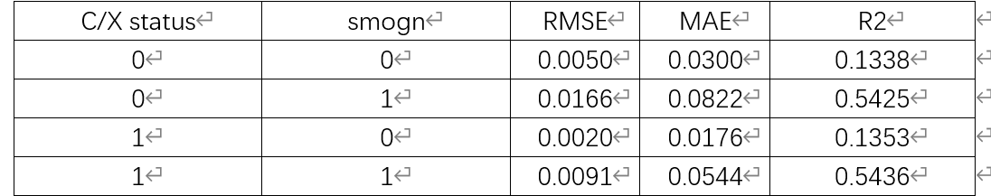

From the results of the non-smogn data, we can also see that all the RMSE, MAE, R2 scores are low. The RMSE and MAE scores are even lower than that of the smogn data. This indicates that due to the data imbalance, the model would lean towards the major class for better RMSE and MAE performance. The R2 score is the metric we would focus on as long as the other two metrics are reasonably low.

## 3.2 Model Implementation

In [ ]:
data_smogn = pd.read_csv('smogn_df_withCX.csv')

NameError: name 'pd' is not defined

In generating the data in the smogn_df_withCX.csv, the data points with STATUS 'C' and 'X' are viewed as the same as those with STATUS 0. As shown in the table above, the results of keeping those data points turned out to be slightly better than that of discarding them.

In [ ]:
data_smogn.head()

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,credit_score,MONTHS_BALANCE,AGE,YEARS_EMPLOYED,income_per_family_member,employment_age_ratio,married
0,5008804.0,M,Y,Y,427500.0,Working,Higher education,Rented apartment,-12005.0,-4542.0,...,0.0,0.0,Unknown,0.960492,16.0,32.0,12.0,213750.0,0.375000,1.0
1,5008805.0,M,Y,Y,427500.0,Working,Higher education,Rented apartment,-12005.0,-4542.0,...,0.0,0.0,Unknown,0.957859,15.0,32.0,12.0,213750.0,0.375000,1.0
2,5008808.0,F,N,Y,270000.0,Commercial associate,Secondary / secondary special,House / apartment,-19110.0,-3051.0,...,1.0,1.0,Sales staff,1.000000,5.0,52.0,8.0,270000.0,0.153846,0.0
3,5008809.0,F,N,Y,270000.0,Commercial associate,Secondary / secondary special,House / apartment,-19110.0,-3051.0,...,1.0,1.0,Sales staff,1.000000,5.0,52.0,8.0,270000.0,0.153846,0.0
4,5008810.0,F,N,Y,270000.0,Commercial associate,Secondary / secondary special,House / apartment,-19110.0,-3051.0,...,1.0,1.0,Sales staff,1.000000,27.0,52.0,8.0,270000.0,0.153846,0.0


In [ ]:
#Encoding
le = LabelEncoder()

object_features = data_smogn.select_dtypes(include='object').columns.tolist()
print(object_features)
for col in object_features:
    data_smogn[col] = le.fit_transform(data_smogn[col])

['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_HOUSING_TYPE', 'OCCUPATION_TYPE']


In [ ]:
# Separate the oversampled data back into X and y
X_resampled = data_smogn.drop(columns=["ID","credit_score"])
y_resampled = data_smogn["credit_score"]
X_train, X_test, y_train, y_test = train_test_split(X_resampled,y_resampled, test_size=0.3)

In [ ]:
#scale the data
scaler = MinMaxScaler()
# Assuming X_train is originally a DataFrame and you want to keep its column names
X_train_scaled = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns)
X_test_scaled = pd.DataFrame(scaler.transform(X_test), columns=X_test.columns)

In [ ]:
X_train_scaled

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,MONTHS_BALANCE,AGE,YEARS_EMPLOYED,income_per_family_member,employment_age_ratio,married
0,1.0,1.0,1.0,0.055233,1.00,1.00,0.2,0.804214,0.035712,0.0,1.0,1.0,0.0,0.444444,0.766667,0.191489,0.119048,0.054558,0.239837,1.0
1,1.0,1.0,1.0,0.156977,1.00,1.00,0.4,0.932422,0.040914,0.0,0.0,1.0,1.0,0.166667,0.283333,0.063830,0.023810,0.092376,0.059959,1.0
2,0.0,0.0,1.0,0.069767,1.00,0.25,0.2,0.649193,0.039302,0.0,0.0,0.0,0.0,0.000000,0.183333,0.340426,0.023810,0.041952,0.038893,1.0
3,0.0,0.0,0.0,0.055233,0.00,0.25,1.0,0.311133,0.040914,0.0,0.0,0.0,0.0,0.000000,0.633333,0.702128,0.095238,0.054558,0.106594,1.0
4,0.0,0.0,1.0,0.069767,0.50,1.00,0.2,0.263995,0.016299,0.0,0.0,1.0,0.0,0.166667,0.183333,0.744681,0.595238,0.067164,0.642422,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22510,0.0,0.0,1.0,0.089535,0.25,1.00,0.2,0.215709,0.995091,0.0,0.0,1.0,0.0,0.944444,0.033333,0.787234,0.000000,0.177088,0.000000,0.0
22511,0.0,0.0,1.0,0.209302,0.50,1.00,0.2,0.442384,0.040914,0.0,0.0,0.0,0.0,0.611111,0.400000,0.553191,0.261905,0.384833,0.336793,0.0
22512,0.0,0.0,0.0,0.084302,1.00,0.50,0.2,0.473790,0.033894,0.0,0.0,0.0,0.0,0.166667,0.866667,0.531915,0.166667,0.079770,0.218982,1.0
22513,0.0,0.0,0.0,0.031977,0.50,1.00,1.0,0.954240,0.039477,0.0,1.0,0.0,0.0,0.611111,0.033333,0.042553,0.023810,0.077249,0.062566,0.0


## **3.3: Linear Regression and Lasso Regression**

The Linear regression model assumes a linear relationship between the independent variables (features) and the dependent variable (target). It works well when the data has a strong linear pattern but struggles with complex, nonlinear relationships.

The Lasso model is a type of linear regression. Its main feature is the addition of an L1 regularization term to the ordinary regression. This term penalizes the absolute values of the regression coefficients, effectively shrinking them. As a result, some coefficients may even become zero, which leads to feature selection, great for reducing complexity and avoiding overfitting.

These 2 models are meant to establish a baseline predictive performance and evaluate linear relationships.

### 3.3.1 Linear Regresssion

In [ ]:
lr = LinearRegression()
lr.fit(X_train_scaled, y_train)

LinearRegression()

In [ ]:
y_train_pred_lr = lr.predict(X_train_scaled)
y_test_pred_lr = lr.predict(X_test_scaled)

print("Linear Regression Training Results:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_train, y_train_pred_lr))}")
print(f"MAE: {mean_absolute_error(y_train, y_train_pred_lr)}")
print(f"R2: {r2_score(y_train, y_train_pred_lr)}\n")

print("Linear Regression Testing Results:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_test_pred_lr))}")
print(f"MAE: {mean_absolute_error(y_test, y_test_pred_lr)}")
print(f"R2: {r2_score(y_test, y_test_pred_lr)}")



# Cross-validation for Linear Regression
kf = KFold(n_splits=5, shuffle=True, random_state=42)

metrics = {
    'neg_root_mean_squared_error': 'RMSE',
    'neg_mean_absolute_error': 'MAE',
    'r2': 'R2'
}

print("Cross-Validation Scores for Linear Regression:\n")
for scoring, label in metrics.items():
    scores = cross_val_score(lr, X_train, y_train, cv=kf, scoring=scoring)
    mean_score = np.mean(scores)

    if 'neg' in scoring:
        mean_score *= -1

    print(f"{label} (Mean): {mean_score:.4f}")

Linear Regression Training Results:
RMSE: 0.14030832147373196
MAE: 0.07108610548182337
R2: 0.018969837570388837

Linear Regression Testing Results:
RMSE: 0.1391298676320033
MAE: 0.06964616538473851
R2: 0.018862173907210678
Cross-Validation Scores for Linear Regression:

RMSE (Mean): 0.1404
MAE (Mean): 0.0712
R2 (Mean): 0.0166


### 3.3.2 Lasso Regression

In [ ]:
lasso = LassoCV(cv=5, random_state=42, max_iter=10000)
lasso.fit(X_train_scaled, y_train)

y_train_pred_lasso = lasso.predict(X_train_scaled)
y_test_pred_lasso = lasso.predict(X_test_scaled)

print("Lasso Regression Training Results:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_train, y_train_pred_lasso)):.4f}")
print(f"MAE: {mean_absolute_error(y_train, y_train_pred_lasso):.4f}")
print(f"R2: {r2_score(y_train, y_train_pred_lasso):.4f}\n")

print("Lasso Regression Testing Results:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_test_pred_lasso)):.4f}")
print(f"MAE: {mean_absolute_error(y_test, y_test_pred_lasso):.4f}")
print(f"R2: {r2_score(y_test, y_test_pred_lasso):.4f}")



kf = KFold(n_splits=5, shuffle=True, random_state=42)

metrics = {
    'neg_root_mean_squared_error': 'RMSE',
    'neg_mean_absolute_error': 'MAE',
    'r2': 'R2'
}

print("Cross-Validation Scores for Linear Regression:\n")
for scoring, label in metrics.items():
    scores = cross_val_score(lasso, X_train, y_train, cv=kf, scoring=scoring)
    mean_score = np.mean(scores)

    if 'neg' in scoring:
        mean_score *= -1

    print(f"{label} (Mean): {mean_score:.4f}")

Lasso Regression Training Results:
RMSE: 0.1403
MAE: 0.0710
R2: 0.0190

Lasso Regression Testing Results:
RMSE: 0.1391
MAE: 0.0696
R2: 0.0188
Cross-Validation Scores for Linear Regression:

RMSE (Mean): 0.1416
MAE (Mean): 0.0724
R2 (Mean): 0.0002


### 3.3.3 Error analysis

The training and testing RMSE values of both models indicate consistent performance, suggesting that the model is not overfitting. The consistent low R² indicates they aren’t capturing the data's complexity well. With low R² values, the predictions might be close to the mean of the target rather than capturing meaningful relationships. The penalty applied by Lasso doesn't seem to improve predictive performance significantly, likely because the relationships in the data remain primarily unexplained. These models lack the ability to capture non-linear relationships in the data.

For the linear model, the cross-validation scores are consistent with the training/testing results. This reaffirms the limited explanatory power of the linear regression model for your dataset. The cross-validation results for Lasso show an even lower R² mean. This suggests that during cross-validation, Lasso struggles to generalize for unseen data. Lasso's feature selection mechanism might be penalizing important features too aggressively, leading to similarly poor explanatory power as linear regression.


### 3.3.4 Residual analysis

In [ ]:
y_train_pred = y_train_pred_lr
y_test_pred = y_test_pred_lr

In [ ]:
y_train_pred = y_train_pred_lasso
y_test_pred = y_test_pred_lasso

In [ ]:
# Calculate residuals
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred

In [ ]:
#Plot Residuals vs. Predicted Values
plt.figure(figsize=(10, 6))

# Training residuals
plt.scatter(y_train_pred, train_residuals, alpha=0.5, label='Train Residuals')
# Test residuals
plt.scatter(y_test_pred, test_residuals, alpha=0.5, label='Test Residuals')

plt.axhline(0, color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residuals vs. Predicted Values')
plt.legend()
plt.show()

In [ ]:
stats.probplot(train_residuals, dist="norm", plot=plt)
plt.title('Q-Q Plot for Train Residuals')
plt.show()

stats.probplot(test_residuals, dist="norm", plot=plt)
plt.title('Q-Q Plot for Test Residuals')
plt.show()

In [ ]:
#Residuals should have consistent variance across predicted values (homoscedasticity).
plt.figure(figsize=(10, 6))

plt.scatter(y_test_pred, np.abs(test_residuals), alpha=0.5, color='blue')
plt.axhline(np.mean(np.abs(test_residuals)), color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Absolute Residuals')
plt.title('Homoscedasticity Check: Absolute Residuals vs. Predicted Values')
plt.show()

In the Homoscedasticity Check plots, the residuals appear scattered across the predicted values, with no clear pattern. This randomness suggests that the assumption of homoscedasticity (constant variance) holds.

In the Q-Q plots, residuals greatly deviate from the red reference line. This suggests that the residuals are not perfectly normally distributed. The curve on the right side of the plot suggests unaccounted complexities in the data that could hint at missing explanatory variables or non-linear patterns in the test data. These deviations might suggest a need for feature engineering, transformations, or consideration of a non-linear model like decision trees or random forests.


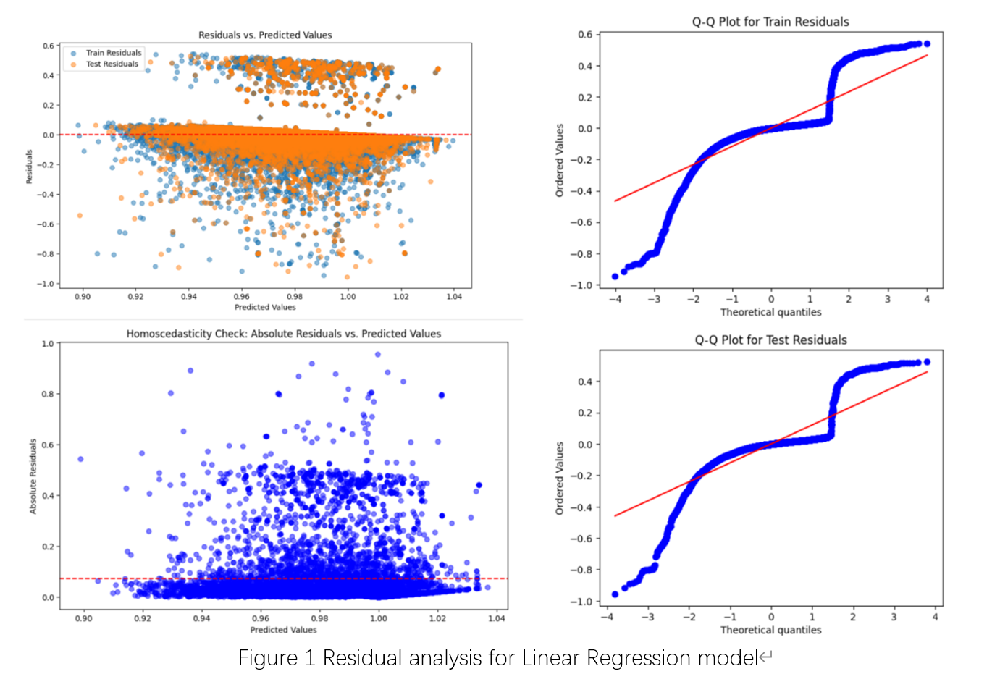

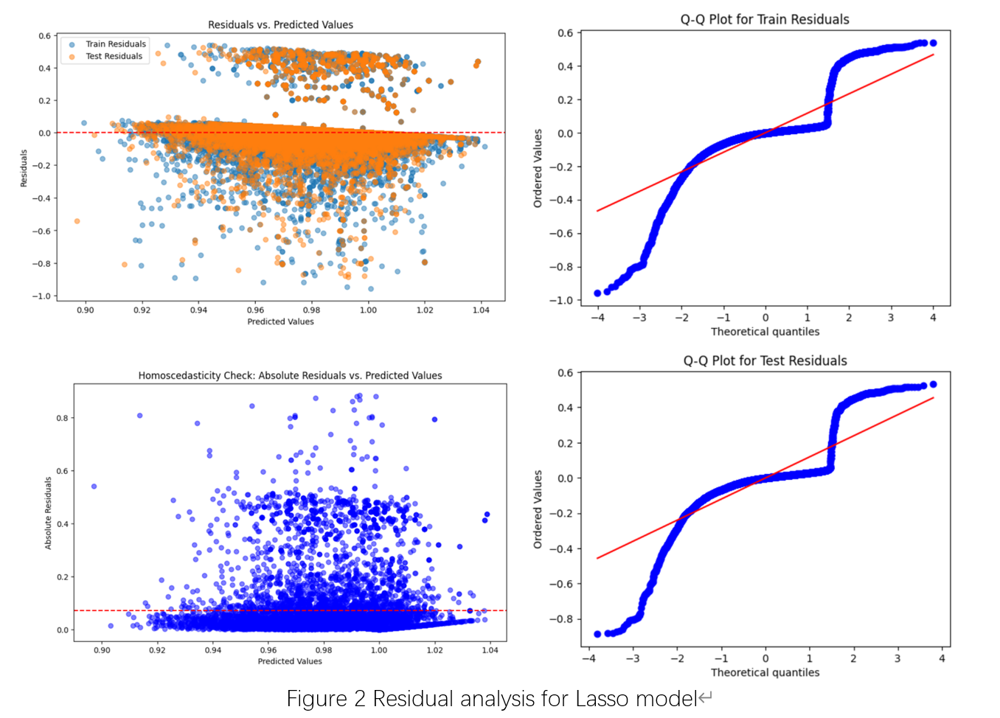

### 3.3.5 Future imporvements

To improve the performance, we need to implement models that has a greater ability to capture the data's complexity. Decision Trees and Random Forests can capture non-linear relationships. They split data based on feature thresholds, creating flexible rules that naturally model complex, non-linear patterns.

## **3.4: Decision Tree and Random Forest**

Decision Tree is a flexible model that splits the data into subsets based on feature values, forming a tree structure. Each node represents a decision rule, and leaves represent predictions. It's intuitive and can handle both regression and classification tasks. However, decision trees can overfit if not properly pruned or regulated.

Random Forest is an ensemble model that builds multiple decision trees and combines their predictions. It reduces the risk of overfitting by aggregating results and performs well with complex, high-dimensional data.

Decision Tree and Random Forest models enable us to capture the non-linear relationships and interactions between features.


### 3.4.1 Decision Tree

In [ ]:
dt = DecisionTreeRegressor(random_state=42)
dt.fit(X_train, y_train)

y_train_pred_dt = dt.predict(X_train)
y_test_pred_dt = dt.predict(X_test)


print("Decision Tree Classifier Training Results:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_train, y_train_pred_dt)):.4f}")
print(f"MAE: {mean_absolute_error(y_train, y_train_pred_dt):.4f}")
print(f"R2: {r2_score(y_train, y_train_pred_dt):.4f}\n")

print("Decision Tree Classifier Testing Results:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_test_pred_dt)):.4f}")
print(f"MAE: {mean_absolute_error(y_test, y_test_pred_dt):.4f}")
print(f"R2: {r2_score(y_test, y_test_pred_dt):.4f}")


param_grid_dt = {
    'max_depth': [5, 10, 15, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2', None]
}

for metric in ['neg_root_mean_squared_error', 'neg_mean_absolute_error', 'r2']:
    print(f"\nRandomizedSearchCV Optimizing for: {metric}")

    grid = RandomizedSearchCV(DecisionTreeRegressor(random_state=42), param_grid_dt, cv=5, scoring=metric)
    grid.fit(X_train, y_train)
    y_pred = grid.best_estimator_.predict(X_test)

    print(f"Best Parameters: {grid.best_params_}")
    print(f"Test RMSE: {np.sqrt(mean_squared_error(y_test, y_pred)):.4f}")
    print(f"Test MAE: {mean_absolute_error(y_test, y_pred):.4f}")
    print(f"Test R2: {r2_score(y_test, y_pred):.4f}")

Decision Tree Classifier Training Results:
RMSE: 0.0309
MAE: 0.0047
R2: 0.9524

Decision Tree Classifier Testing Results:
RMSE: 0.1180
MAE: 0.0455
R2: 0.2948

RandomizedSearchCV Optimizing for: neg_root_mean_squared_error
Best Parameters: {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': None}
Test RMSE: 0.1074
Test MAE: 0.0401
Test R2: 0.4149

RandomizedSearchCV Optimizing for: neg_mean_absolute_error
Best Parameters: {'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': 'log2', 'max_depth': 20}
Test RMSE: 0.1127
Test MAE: 0.0537
Test R2: 0.3563

RandomizedSearchCV Optimizing for: r2
Best Parameters: {'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': None}
Test RMSE: 0.1074
Test MAE: 0.0401
Test R2: 0.4149


### 3.4.2 Random Forest

In [ ]:
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train, y_train)

y_train_pred_rf = rf.predict(X_train)
y_test_pred_rf = rf.predict(X_test)


print("Random Forest Classifier Training Results:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_train, y_train_pred_rf)):.4f}")
print(f"MAE: {mean_absolute_error(y_train, y_train_pred_rf):.4f}")
print(f"R2: {r2_score(y_train, y_train_pred_rf):.4f}\n")

print("Random Forest Classifier Testing Results:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_test_pred_rf)):.4f}")
print(f"MAE: {mean_absolute_error(y_test, y_test_pred_rf):.4f}")
print(f"R2: {r2_score(y_test, y_test_pred_rf):.4f}")



param_grid_rf = {
    'max_depth': [5, 10, 15, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2', None]
}

for metric in ['neg_root_mean_squared_error', 'neg_mean_absolute_error', 'r2']:
    print(f"\nRandomisedSearchCV Optimizing for: {metric}")

    grid = RandomizedSearchCV(RandomForestRegressor(random_state=42), param_grid_rf, cv=5, scoring=metric)
    grid.fit(X_train, y_train)
    y_pred = grid.best_estimator_.predict(X_test)

    print(f"Best Parameters: {grid.best_params_}")
    print(f"Test RMSE: {np.sqrt(mean_squared_error(y_test, y_pred)):.4f}")
    print(f"Test MAE: {mean_absolute_error(y_test, y_pred):.4f}")
    print(f"Test R2: {r2_score(y_test, y_pred):.4f}")


Random Forest Classifier Training Results:
RMSE: 0.0423
MAE: 0.0179
R2: 0.9110

Random Forest Classifier Testing Results:
RMSE: 0.0856
MAE: 0.0409
R2: 0.6286

RandomisedSearchCV Optimizing for: neg_root_mean_squared_error
Best Parameters: {'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': 'sqrt', 'max_depth': None}
Test RMSE: 0.0917
Test MAE: 0.0474
Test R2: 0.5738

RandomisedSearchCV Optimizing for: neg_mean_absolute_error
Best Parameters: {'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 20}
Test RMSE: 0.0914
Test MAE: 0.0473
Test R2: 0.5762

RandomisedSearchCV Optimizing for: r2
Best Parameters: {'min_samples_split': 2, 'min_samples_leaf': 4, 'max_features': None, 'max_depth': None}
Test RMSE: 0.0956
Test MAE: 0.0497
Test R2: 0.5372


### 3.4.3 Error analysis

Compared with linear regression and Lasso models, Decision tree and Random Forest models demonstrate improvement both in accuracy and its ability to capture the variance in the target variable.

For the Decision Tree model, the training results indicate that it performs exceptionally well on the training set. The high R² value shows that the model captures most of the variance in the target variable. The testing results highlight a significant drop in performance compared to the training results. The lower R² value (0.3452) suggests that the model struggles to generalize on unseen data. This disparity between training and testing performance is a hallmark of overfitting.

In theory, strategies like limiting tree depth (max_depth) and increasing the minimum samples per leaf (min_samples_leaf) can help reduce overfitting. But the results from Randomized Search CV indicate that such hyperparameter tuning can't provide much improvement in generalization.



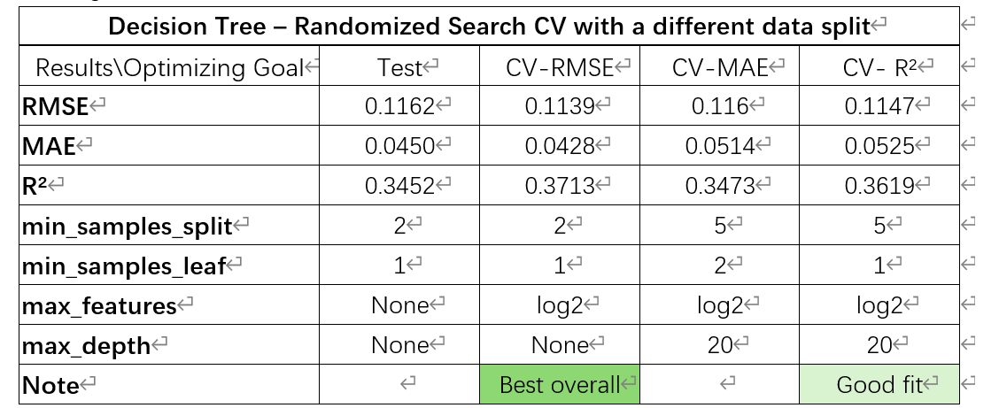

For the Random Forest model, while the training results are slightly worse than the Decision Tree, the R² value in the testing results demonstrate that the model's generalization to unseen data is strengthened greatly. The clear difference in performance between training and testing sets, indicates that while Random Forest is inherently less prone to overfitting, some improvement is needed for better generalization.

The tuned models yield minor improvements in RMSE, MAE, and R², suggesting that the model is reasonably robust but might require further regularization for higher generalization performance. There is a potential plateau in performance gains.

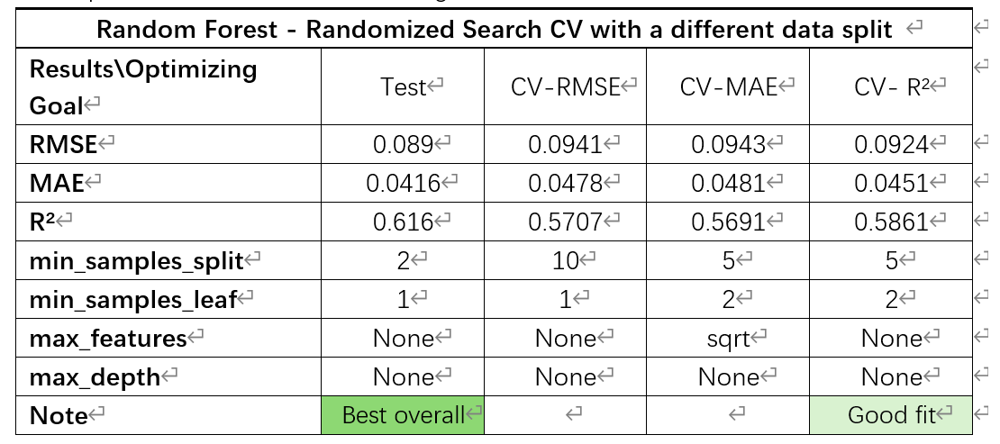

### 3.4.4 Residual analysis

In [ ]:
y_train_pred = y_train_pred_dt
y_test_pred  = y_test_pred_dt

In [ ]:
y_train_pred = y_train_pred_rf
y_test_pred  = y_test_pred_rf

In [ ]:
# Calculate residuals
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred

#Plot Residuals vs. Predicted Values
plt.figure(figsize=(10, 6))

# Training residuals
plt.scatter(y_train_pred, train_residuals, alpha=0.5, label='Train Residuals')
# Test residuals
plt.scatter(y_test_pred, test_residuals, alpha=0.5, label='Test Residuals')

plt.axhline(0, color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residuals vs. Predicted Values')
plt.legend()
plt.show()

In [ ]:
#Check if residuals follow a normal distribution:
stats.probplot(train_residuals, dist="norm", plot=plt)
plt.title('Q-Q Plot for Train Residuals')
plt.show()

stats.probplot(test_residuals, dist="norm", plot=plt)
plt.title('Q-Q Plot for Test Residuals')
plt.show()

In [ ]:
#Residuals should have consistent variance across predicted values (homoscedasticity).
plt.figure(figsize=(10, 6))

plt.scatter(y_test_pred, np.abs(test_residuals), alpha=0.5, color='blue')
plt.axhline(np.mean(np.abs(test_residuals)), color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Absolute Residuals')
plt.title('Homoscedasticity Check: Absolute Residuals vs. Predicted Values')
plt.show()

For the Decision Tree model, Residuals for the test dataset (orange) show a wider spread and are less centred around zero. This points to higher prediction errors for unseen data, indicative of overfitting. The residuals are also not distributed evenly across the predicted value, displaying an almost linear relationship.

The Q-Q plot for train set fit much better than the one for the test set, indicating overfit. They both have deviations at the tail, showing the residuals have more extreme values than expected under normality.


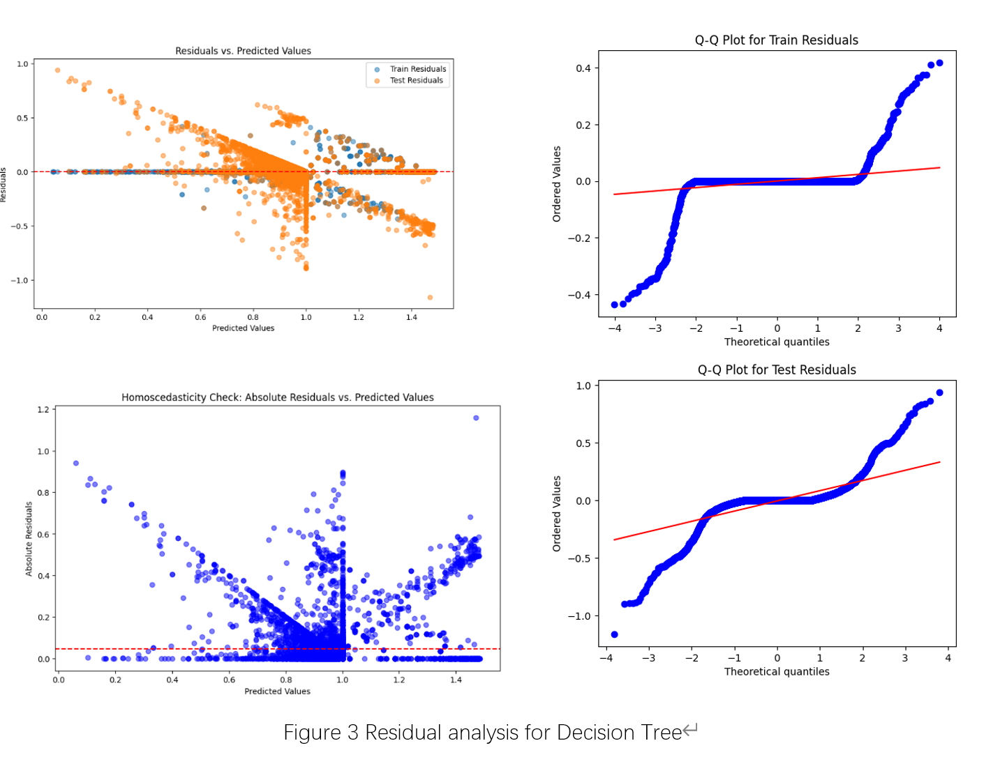

For the Random Forest model, the residuals are smaller than that of the decision tree. The Q-Q plots have deviations at the tail, showing the residuals have more extreme values than expected under normality. The heavy-tailed residuals may be due to outliers or data complexity.

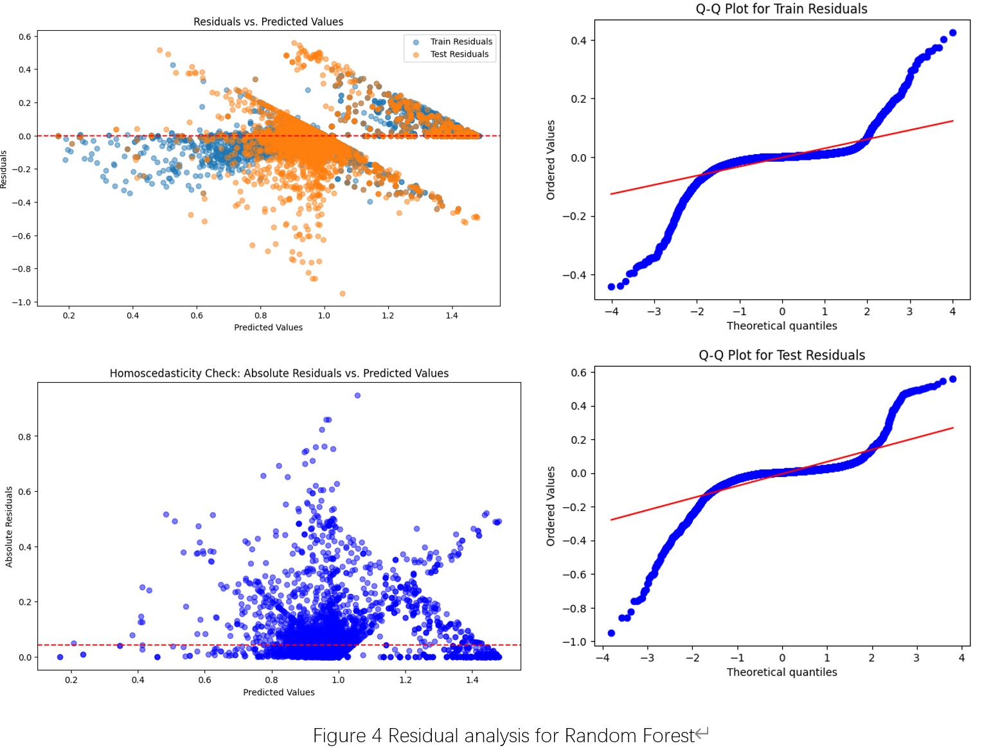

Both the Homoscedasticity Check plots show that there is a noticeable pattern where the residual variance changes as the predicted values increase, meaning the residuals' variance is not uniform. Decision Tree and Random Forest models do not rely on the assumption of homoscedasticity (constant variance across residuals) as linear regression does. Heteroscedasticity is generally not an issue for these models. In fact, it can indicate that the models are capturing non-linear relationships or complex patterns within the dataset.


### 3.4.5 Future improvements

To further improve the performance, we consider gradient boosting methods (i.e., LightGBM) for better generalization and fine-tuning capability.

## **3.5: Light GBM**

LightGBM is a gradient boosting model that is efficient for large datasets and robust in handling missing values. It’s a highly efficient gradient boosting algorithm that creates decision tree-based ensembles, designed for speed and scalability. Its features include leaf-wise growth and flexibility with hyperparameters, making it capable of handling large datasets with many features while providing accurate predictions.

In [ ]:
train_data = lgb.Dataset(X_train_scaled, label=y_train)
test_data = lgb.Dataset(X_test_scaled, label=y_test)

### 3.5.1 Hyperparameter Tuning with grid search

In [ ]:
model = lgb.LGBMRegressor()

# Define the parameter grid
param_grid = {
    'learning_rate': [0.4],
    'num_leaves': [600],
    'max_depth': [-1],
    'feature_fraction': [0.6, 0.8, 1.0],
    'bagging_fraction': [0.8, 1.0],
    'min_data_in_leaf': [5,10, 20, 50],
    'bagging_freq': [5,10],
    'boosting': ['dart'],
}

grid_search = GridSearchCV(
    estimator=model,
    param_grid=param_grid,
    scoring='r2',  #
    cv=5,
    verbose=1,
    n_jobs=-1
)
grid_search.fit(X_train, y_train)

# Get the best parameters
print("Best Parameters:", grid_search.best_params_)
print("Best R2 Score:", grid_search.best_score_)

y_pred = grid_search.best_estimator_.predict(X_test)
print(f"Test RMSE: {np.sqrt(mean_squared_error(y_test, y_pred)):.4f}")
print(f"Test MAE: {mean_absolute_error(y_test, y_pred):.4f}")
print(f"Test R2: {r2_score(y_test, y_pred):.4f}")

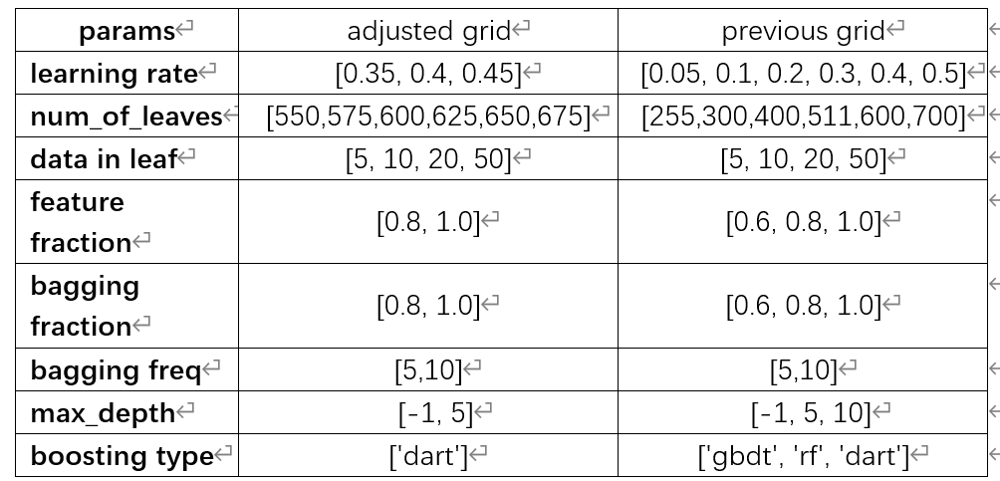

In [ ]:
# Define the parameter grid
param_grid = {
    'learning_rate': [0.35, 0.4, 0.45],
    'num_leaves': [550,575,600,625,650,675],
    'max_depth': [-1, 5, 10],
    'boosting': ['dart'],

    'bagging_fraction': [1.0],
    'bagging_freq': [5],
    'feature_fraction': [0.8],
    'min_data_in_leaf': [5],
}

# Create the grid search object
grid_search = GridSearchCV(
    estimator=model,
    param_grid=param_grid,
    scoring='r2',  #
    cv=5,
    verbose=1,
    n_jobs=-1
)
grid_search.fit(X_train, y_train)

# Get the best parameters
print("Best Parameters:", grid_search.best_params_)
print("Best R2 Score:", grid_search.best_score_)

y_pred = grid_search.best_estimator_.predict(X_test)
print(f"Test RMSE: {np.sqrt(mean_squared_error(y_test, y_pred)):.4f}")
print(f"Test MAE: {mean_absolute_error(y_test, y_pred):.4f}")
print(f"Test R2: {r2_score(y_test, y_pred):.4f}")

### 3.5.2 Best parameter model

In [ ]:
params = {
    'objective': 'regression',
    'boosting_type': 'dart',
    'learning_rate': 0.4,
    'max_depth': -1,
    'num_leaves': 600,

    'bagging_fraction': 1.0,
    'bagging_freq': 5,
    'feature_fraction': 0.8,
    'min_data_in_leaf': 5,
}

In [ ]:
bst = lgb.train(params, train_data,2000)

In [ ]:
# Predict on validation set
y_train_pred_lightGBM = bst.predict(X_train_scaled)
y_test_pred_lightGBM = bst.predict(X_test_scaled)

# Calculate evaluation metrics
rmse_train = mean_squared_error(y_train, y_train_pred_lightGBM)
mae_train = mean_absolute_error(y_train, y_train_pred_lightGBM)
r2_train = r2_score(y_train, y_train_pred_lightGBM)

rmse_test = mean_squared_error(y_test, y_test_pred_lightGBM)
mae_test = mean_absolute_error(y_test, y_test_pred_lightGBM)
r2_test = r2_score(y_test, y_test_pred_lightGBM)

print("LightGBM Classifier Training Results:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_train, y_train_pred_rf)):.4f}")
print(f"MAE: {mean_absolute_error(y_train, y_train_pred_rf):.4f}")
print(f"R2: {r2_score(y_train, y_train_pred_rf):.4f}\n")

print("LightGBM Classifier Testing Results:")
print(f"RMSE: {np.sqrt(mean_squared_error(y_test, y_test_pred_rf)):.4f}")
print(f"MAE: {mean_absolute_error(y_test, y_test_pred_rf):.4f}")
print(f"R2: {r2_score(y_test, y_test_pred_rf):.4f}")

### 3.5.3 Error analysis

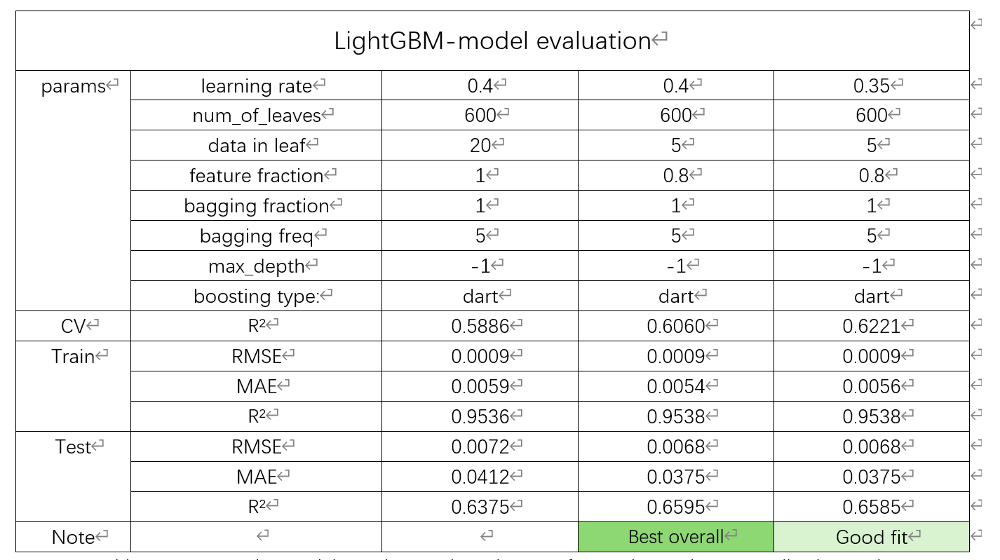

Compared with the Random Forest model, the performance of LightGBM sees an improvement in both accuracy and ability to capture the data's complexity. The RMSE and MAE values are strikingly better on the train set. RSME on the test set remain greatly improved while MAE only sees a slight improvement. The R² on the train set was higher too, in fact exceeding that of the overfitting Decision Tree Model. The R² score on the test set increased by 3% compared with the Random Forest model.

This may be due to the boosting option 'dart'. 'DART' stands for Dropouts meet Multiple Additive Regression Trees. It addresses a common issue in gradient-boosted decision trees called over-specialization, where trees added later in the boosting process contribute minimally to the overall model and focus too narrowly on specific instances. DART introduces the concept of dropouts, inspired by neural networks, to randomly drop trees during training. This encourages the model to rely on a broader set of trees, improving generalization and reducing overfitting.

The clear difference in performance between training and testing sets, indicates that while the overfitting issue still exists. While hyper parameter tuning slightly improves the performance during training and testing, the changes are negligible, suggesting a potential plateau in performance gains.


### 3.5.4 Residual analysis

In [ ]:
y_train_pred = y_train_pred_lightGBM
y_test_pred  = y_test_pred_lightGBM

In [ ]:
train_residuals = y_train - y_train_pred
test_residuals = y_test - y_test_pred
# Mean and variance of residuals
print("Train Residuals Mean:", np.mean(train_residuals))
print("Test Residuals Mean:", np.mean(test_residuals))
print("Train Residuals Variance:", np.var(train_residuals))
print("Test Residuals Variance:", np.var(test_residuals))

Close-to-zero residual means on both sets show that the model is making predictions with minimal bias. The relatively low variance on the training set suggests that the residuals are not widely dispersed, meaning the model is consistently accurate on the training data.

In [ ]:
#Plot Residuals vs. Predicted Values
plt.figure(figsize=(10, 6))

# Training residuals
plt.scatter(y_train_pred, train_residuals, alpha=0.5, label='Train Residuals')
# Test residuals
plt.scatter(y_test_pred, test_residuals, alpha=0.5, label='Test Residuals')

plt.axhline(0, color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residuals vs. Predicted Values')
plt.legend()
plt.show()

In [ ]:
#Check if residuals follow a normal distribution:
plt.figure(figsize=(10, 6))

# Histogram for training residuals
plt.hist(train_residuals, bins=50, alpha=0.5, label='Train Residuals')
# Histogram for test residuals
plt.hist(test_residuals, bins=50, alpha=0.5, label='Test Residuals')

plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.title('Histogram of Residuals')
plt.legend()
plt.show()

In [ ]:
#Residuals should have consistent variance across predicted values (homoscedasticity).
plt.figure(figsize=(10, 6))

plt.scatter(y_test_pred, np.abs(test_residuals), alpha=0.5, color='blue')
plt.axhline(np.mean(np.abs(test_residuals)), color='red', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Absolute Residuals')
plt.title('Homoscedasticity Check: Absolute Residuals vs. Predicted Values')
plt.show()

The variance of the test residuals is notably higher than the training residuals' variance. This reflects that the predictions on unseen data are less consistent compared to the training data, which is typical but could indicate slight overfitting.


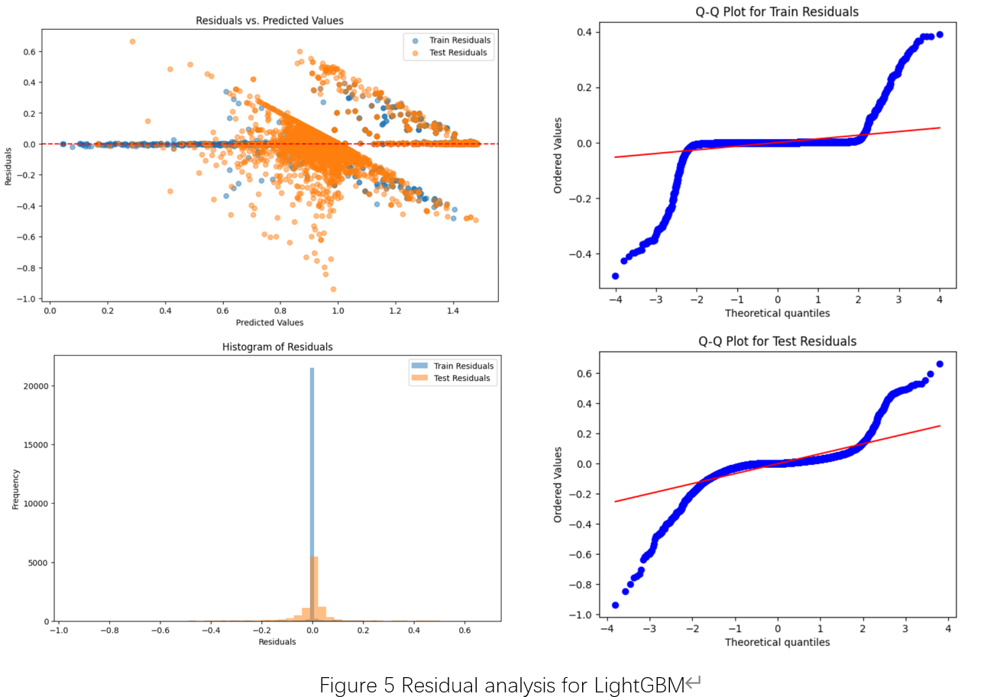

### 3.5.5 Feature importance analysis

In [ ]:
lgb.plot_importance(bst)

In [ ]:
feature_importances = bst.feature_importance(importance_type='split')
features = X_train_scaled.columns

# Create a DataFrame for visualization
importance_df = pd.DataFrame({'Feature': features, 'Importance': feature_importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False)

print(importance_df)

# Set a threshold for importance
threshold = 40000
selected_features = importance_df.loc[importance_df['Importance'] > threshold, 'Feature']

# Subset the original data
X_train_selected = X_train_scaled[selected_features]
X_test_selected = X_test_scaled[selected_features]

print("Selected Features:", selected_features.tolist())

In [ ]:
train_data3 = lgb.Dataset(X_train_selected, label=y_train) #selected >10000 top18/20, 40000:top 9
test_data3 = lgb.Dataset(X_test_selected, label=y_test)

In [ ]:
bst3 = lgb.train(params, train_data3,2000)

# Predict on validation set
y_train_pred_lightGBM = bst3.predict(X_train_selected)
y_test_pred_lightGBM = bst3.predict(X_test_selected)

# Calculate evaluation metrics
rmse_train = mean_squared_error(y_train, y_train_pred_lightGBM)
mae_train = mean_absolute_error(y_train, y_train_pred_lightGBM)
r2_train = r2_score(y_train, y_train_pred_lightGBM)

rmse_test = mean_squared_error(y_test, y_test_pred_lightGBM)
mae_test = mean_absolute_error(y_test, y_test_pred_lightGBM)
r2_test = r2_score(y_test, y_test_pred_lightGBM)

print(rmse_train)
print(mae_train)
print(f"{r2_train}")

print(rmse_test)
print(mae_test)
print(f"{r2_test}")

Compared with Lasso, the LightGBM apparently made better usage of the various features, The top features are MONTHS_BALANCE , DAYS_BIRTH , DAYS_EMPLOYED and income features, which is in accordance with that of the Random Forest Tree model.



When we train the model on a dataset with selected feature, we can see that the performance is slightly worse. We selected the top 9 features (importance over 40000) as there is a signifigant drop in importance in the next feature. It indicates that the features all contain more or less useful information for regression, while their contribution may be negligible when considering the space and time they cost when implementing the model.


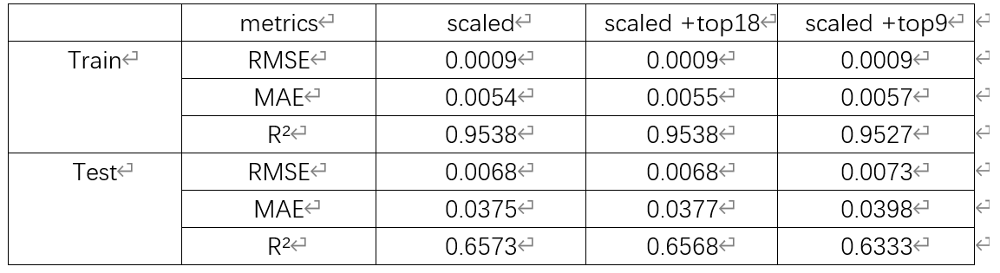

### 3.5.6 Future improvements

To better the performance further, we may attempt to generate more new features from existing data and conduct feature selection.

Secondly, the hyperparameter tuning was done through searching the following grids. While the changes may be negligible, further searching near the present best parameters may still yield slightly better results.

Furthermore, combining the LightGBM model with other models like XGBoost may also improve the performance.

## **3.6 Overall Evaluation**

There is a clear progression of models from linear regression to LightGBM in handling data complexity and predictive accuracy. The linear regression and Lasso models provided a foundational analysis but struggled to capture non-linear relationships, showing consistent RMSE values but low R² scores. Decision Tree and Random Forest models improved on non-linear relationships, with Random Forest balancing generalization better than Decision Tree. LightGBM demonstrated further performance gains compared with Random Forest models with enhanced R², leveraging the DART mechanism to avoid over-specialization. Despite the slight but persistent overfitting, the LightGBM model marked progress in capturing data intricacies while hinting at a performance plateau. Future steps include exploring data features and hybrid models like XGBoost to push the boundaries of generalization and precision.

# **4: Unsupervised**

## **4.1: Preprocessing**

We first preprocess the data to ready it for training and testing. The preprocessing steps are as follows:
1. Apply definition of bad credit and encode categorical variables
2. Check for missing data
3. Remove duplicate IDs to reduce class imbalance
4. Scaling data

In [ ]:
# outer join the 2 dataset together
merged_df = pd.merge(credit, application, on='ID', how='outer')

df = merged_df.copy()
df['credit_status'] = df['STATUS'].apply(lambda x: 1 if x in ['2', '3', '4', '5'] else 0)
df.drop(['STATUS'], axis=1, inplace=True)
label_cols = df.select_dtypes(include=['object', 'category']).columns.to_list()

label_map_dic = {} # labels integer mapping diction
for col in label_cols:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])

    # Check the label-to-integer mapping
    label_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
    label_map_dic[col] = label_mapping

df_clean = df.dropna().copy()

In [ ]:
# Anlaysis on number of missing data
print(f"Percentage of Data Dropped due to NAs: {(credit.shape[0] - df.dropna().shape[0])/credit.shape[0]*100:.2f}%")
print(f"Percentage of bad credit (anomalies) in the data {df_clean[df_clean['credit_status'] == 1].shape[0]/df_clean.shape[0]*100:.2f}%")

Percentage of Data Dropped due to NAs: 26.72%
Percentage of bad credit (anomalies) in the data 0.19%


Outer joined to retain all datapoints in both dataframes. However, the NaNs have to be dropped due to model limitations in its ability to handle Nans. It can be observed that the NaNs reduced the number of rows by half. However, based on the number of rows in the original credit and appication datasets, the loss in data is approximately 25.8% which is still relatively acceptable

In [ ]:
# Keep first month each ID was deemed as bad credit
# Keep the most recent month (i.e., max month value) for IDs that never identified as bad credit

# Separate defaulted and non-defaulted IDs
defaulted = df_clean[df_clean['credit_status'] == 1]
non_defaulted = df_clean[df_clean['credit_status'] == 0]

# Get first default month for each defaulted ID
first_default_idx = defaulted.groupby('ID')['MONTHS_BALANCE'].idxmin()
df_first_default = df_clean.loc[first_default_idx]

# Get latest month for each non-defaulted ID
non_defaulted = non_defaulted[~non_defaulted.ID.isin(defaulted.ID.unique())] # exclude the IDs who have defaulted at least once to avoid dupes
latest_nondefault_idx = non_defaulted.groupby('ID')['MONTHS_BALANCE'].idxmax()
df_latest_nondefault = df_clean.loc[latest_nondefault_idx]

final_df = pd.concat([df_first_default, df_latest_nondefault], ignore_index=True)
final_df = final_df.sort_values(by='ID').reset_index(drop=True)

In [ ]:
final_df.credit_status.sum()/len(final_df.credit_status)

np.float64(0.00731200664727877)

After merging and removing the missing data, we filtered out the dataset to only include one entry for each unqiue ID. To achieve this, we select the first month where the ID exhibited 'Bad Credit' and for 'Good Credit' IDs, we keep their latest month that was last recorded. Hence, under the definition that delinquencies of more than 60 days are labelled as 'Bad Credit', the percentage of unique clients that are labelled as 'Bad credit' is 1.689%.

In [ ]:
scaler = StandardScaler()
X_df = final_df.drop(columns=["credit_status", "ID"]) # ID is not needed
X_scaled_df = scaler.fit_transform(X_df)
X_scaled_df = pd.DataFrame(X_scaled_df, columns=X_df.columns)

y_df = final_df["credit_status"] # Does not need to be scaled

## **4.2: K-Means**

K-Means is an unsupervised machine learning algorithm commonly used for clustering tasks. It groups similar data points together based on feature similarity and attempts to partition the dataset into `k` distinct, non-overlapping clusters.

The algorithm works by:
1. Selecting `k` initial cluster centroids (we will do hyperparameter tuning for the best result)
2. Assigning each data point to the nearest centroid
3. Updating centroids based on the mean of the assigned points
4. Repeating the process until convergence

The goal is to minimize the total within-cluster variance, also known as **inertia**. K-Means is sensitive to the choice of `k` and the initial placement of centroids, so selecting appropriate hyperparameters is important for achieving meaningful clustering results.

`kmeans = KMeans(n_clusters=k, n_init=n_init, init=init_method, random_state=run)`

The parameters for K-Means are:

**1. n_clusters (k):** This sets the number of clusters the algorithm will search for in your data. Essentially, it's the k in k-means, telling the algorithm into how many groups the data should be partitioned.

**2. n_init (n_init):** This determines how many times the algorithm will run with different starting centroid seeds. Multiple runs help ensure that you find a good clustering solution, as the final result will be the one with the lowest within-cluster sum-of-squares (inertia) among all the runs.

**3. init (init_method):** This specifies the method for initializing the centroids. The typical method is "k-means++", which improves the speed and quality of convergence by choosing centroids that are distant from each other. Alternatively, "random" can be used, which randomly selects initial centroids, but is not recommended and thus we will not use it.

**4. random_state (run):** This sets the seed for the random number generator used during centroid initialization. Setting this parameter allows you to get reproducible results each time you run your clustering analysis.

### 4.2.1 Relevance to the problem


K-Means clustering is an effective choice for this credit risk dataset project for several reasons:

**1. Centroid-Based Clustering:**
K-Means works by finding central points (centroids) that minimize the within-cluster sum of squares (WCSS). In the credit risk context, each centroid can represent a typical risk profile (e.g., low-risk, moderate-risk, high-risk). This direct association is valuable for interpreting credit characteristics and tailoring financial strategies.

**2. Scalability and Computational Efficiency:**
Credit risk datasets can be large and high-dimensional. Once it is standardized and potentially reduced the data with PCA, K-Means is particularly efficient. It's simplicity—based on iterative minimization of distances—allows us to quickly explore different numbers of clusters (using, for example, the elbow method or silhouette scores) without incurring high computational costs.

**3. Effectiveness on Scaled, Continuous Data:**
The features in your dataset (such as income, delinquency history, or credit utilization) are continuous and benefit from scaling. K-Means relies on Euclidean distance, which is most meaningful when data is scaled to a comparable range. This makes it a natural fit for the pre-processed, standardized data (X_scaled_df).

**4. Ease of Evaluation and Hyperparameter Tuning:**
The performance of K-Means can be straightforwardly assessed using well-known metrics such as the silhouette score, inertia (WCSS), and the Davies-Bouldin index. This ease of evaluation allows us to efficiently tune the number of clusters and ensure the clustering results are robust and aligned with the underlying structure of the credit data.



### 4.2.2 K-Means Pre-processing

PCA Tuning Approach

PCA is commonly applied to K-Means standardized features (X_scaled_df) because of:

**1. Dimensionality Reduction:**
High-dimensional data in this project dataset can dilute the effectiveness of distance metrics, as distances in high dimensions tend to become less informative (curse of dimensionality). By reducing the number of features while preserving most of the variance, PCA creates a ower-dimensional representation that makes the distances computed in K-Means more meaningful

**2. Noise Reduction:**
Not all dimensions (features) contribute equally to the underlying structure of the data. PCA helps filter out noise and redundant information by focusing on the principal components that capture the most variance.

Choose n_components by Cumulative Explained Variance
1. Fit PCA incrementally from 1 component up to min(n_samples, n_features) components
2. Track the cumulative explained variance ratio at each step
3. Decide a treshold of 90%

We decided the treshold as 90% since:

Retaining 90% of the total variance ensures that the principal components capture the most important structure in the data while filtering out noise and redundant information.

Reducing dimensions to only components that account for 90% of the variance, we are simplifying the dataset without sacrficing essential information.

In many credit risk application, a 90% treshold is a practical balance. It ratains sufficient information for cluster differentiation while discarding less useful variance.

fewer, more informative dimensions, K-Means is less likely to be misled by noise or redundant features. More clarity promotes more stable and robust clusters.

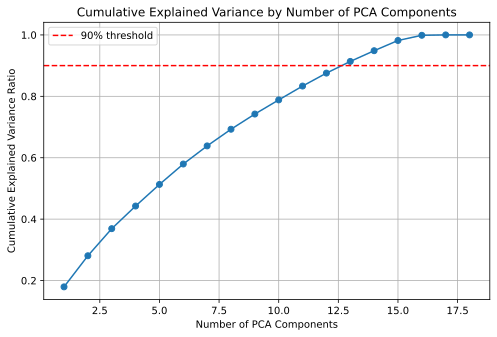

Number of components to reach at least 90% variance: 13


In [ ]:
# Calculate cumulative explained variance for each number of components
pca_variances = []
num_features = X_scaled_df.shape[1]
for n_components in range(1, num_features + 1):
    pca = PCA(n_components=n_components, random_state=42)
    pca.fit(X_scaled_df)
    cumulative_variance = sum(pca.explained_variance_ratio_)
    pca_variances.append(cumulative_variance)

# Plot the cumulative explained variance
plt.figure(figsize=(8, 5))
plt.plot(range(1, num_features + 1), pca_variances, marker='o')
plt.title("Cumulative Explained Variance by Number of PCA Components")
plt.xlabel("Number of PCA Components")
plt.ylabel("Cumulative Explained Variance Ratio")
plt.axhline(y=0.90, color='r', linestyle='--', label='90% threshold')  # Optional reference
plt.legend()
plt.grid(True)
plt.show()

# Determine the optimal number of components: the elbow point or where variance >= 90%
threshold = 0.90
best_n_components = next((i for i, cum_var in enumerate(pca_variances, start=1) if cum_var >= threshold), num_features)
print(f"Number of components to reach at least {threshold*100:.0f}% variance: {best_n_components}")

So, here we found that the best_n_components which gives 90% variance is 14 components.

Thus, next we PCA the X_scaled_df

In [ ]:
pca = PCA(n_components=best_n_components)
X_pca = pca.fit_transform(X_scaled_df)

### 4.2.3 Elbow Method

For each candidate k, run k-means and record its inertia (the total within-cluster sum of squared distances).

Then, plot Inertia vs. k, on the x-axis you have k, on the y-axis you have corresponding inertia. You will see a monotically decreasing curve. Adding more clusters always reduces inertia, but with diminishing returns.

Look for the point on the curve where the rate of decrease sharply slows down, which looks like an elbow in the graph. Up to that point, each extra cluster gives you a big drop in inertia; beyond it, adding clusters produces only tiny improvements. That point of diminishing is the chosen best k found.

#### 4.2.3.1 Hyperparameter Tuning (Elbow Method & Enhanced)

`K_range = range(2, 11)`

We are tuning the best hyperparameter k (which is the n_clusters) ranging from 2 to 10 for couple of reasons:

**1. Minimum Clusters**
Clustering into just 1 group does not provide any segmentation. We want to split the data into at least 2 distinct groups, so starting at 2.

**2. Reasonable Exploration:**
Choosing values up to 10 provides a practical range to explore without overcomplicating the analysis and sufficient to capture the grouping structure in many datasets. If we extend the range beyond 10, the elbow method typically identifies the point where additional clusters yield only marginal reductions in inetria. This means that the optimal number of clusters (the "elbow") is already evident within the 2 to 10 range.

In other words, by increasing the range, we can see that after the elbow point the inertia decreases very gradually. This plateau indicates that the real structure of the data is captured within the initial range, and the best k remains unchanged even if we test if for higher values.

Thus, increasing the search range further than 10 does not alter the final selection of best k.

##### 4.2.3.1.1 Tuning k (Traditional Elbow Method)



plot k vs. inertia for fixed init and n_init, then mathematically pick the elbow using kneed.

Here, we fixed random_state = 42.
random_state is the random centroid initialization. People often use the value 42 as a default and consistent seed. However, any other numbers could be used as well as long as there is consistency in using it.

we fixed n_init = 10
this is the default value. Higher n_init means better clustering, but is also slower (trade-off). People take the value 10 as it is a good trade-off between reliability, runtime, and simplicity.

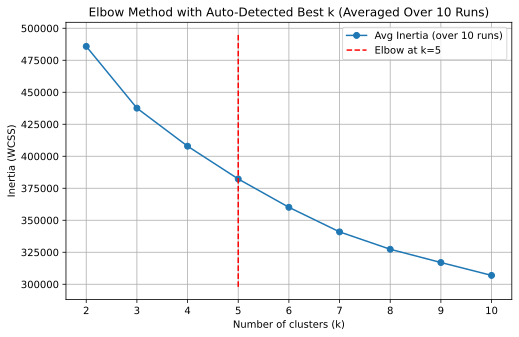

The best number of clusters (k) is: 5


In [ ]:
inertia = []
K_range = range(2, 11)
n_runs = 10  # number of repetitions per k

for k in K_range:
    inertia_runs = []
    for run in range(n_runs):
        kmeans = KMeans(n_clusters=k, random_state=run, n_init=10)
        kmeans.fit(X_pca)
        inertia_runs.append(kmeans.inertia_)

    avg_inertia = sum(inertia_runs) / len(inertia_runs)
    inertia.append(avg_inertia)

# Use KneeLocator to detect the elbow
kneedle = KneeLocator(
    list(K_range), inertia, curve="convex", direction="decreasing"
)
best_k = kneedle.knee

# Plot the elbow curve
plt.figure(figsize=(8, 5))
plt.plot(K_range, inertia, marker='o', label='Avg Inertia (over 10 runs)')
plt.vlines(best_k, plt.ylim()[0], plt.ylim()[1], linestyles='dashed', colors='red', label=f'Elbow at k={best_k}')
plt.title('Elbow Method with Auto-Detected Best k (Averaged Over 10 Runs)')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia (WCSS)')
plt.legend()
plt.grid(True)
plt.show()

print(f"The best number of clusters (k) is: {best_k}")

Observing the plot, Initially, as the k increases, the WCSS decreases sharply because the data is split into more detailed clusters. However, after k=5, the WCSS reduction becomes marginal, meaning that increasing k further does not substantially improve the fit of the clustering model. k=5 here is referred as the "elbow" of the curve.

Thus, from the traditional elbow method, we get the best number of clusters "k=5" by using KneeLocator to detect the "elbow".

This k=5 means the best clustering is to select 5 as the cluster centroids (5 groups the data should be partitioned into).

We can try to explore enhanced version which gives us a more thorough and reliable approach to identifying the optimal hyperparameters for KMeans clustering in the next section.

##### 4.2.3.1.2 Enhanced version of Elbow Method

1. Evaluate the stability and performance over multiple initialization settings

2. Averaging out randomness over several runs

3. Provide both quantitative (intertia values) and qualitative (visual heatmap) evidence to support the final choice


This enhanced version of the elbow method goes beyond simply varying the number of clusters (k) and fixes parameters like n_init and random_state.

**1. Initialization variablity**
In basic k-means, the clustering result is sensitive to random initialization of centroids, which is defined by fixes n_init=10 and random_state=42 (for time-complexity trade-off), which might not fully capture how initialization affects the final inertia. By varying n_init over several values, we should get a broader view of the algorithm's behaviour.

**2. Good estimation of inertia**
Running multiple iterations (with different random seeds) for every (k, n_init) combination and averaging the inertia provides a more reliable metric, where increasing the k will no longer meaningfully decreases the inertia.

Here, we limit n_init_values to 30 since values higher than this will be much slower (time constraint) and testing further higher n_init_values will not affect the K-Means significantly

Best hyperparameter combination (elbow-based):
Best k = 6, Best n_init = 30


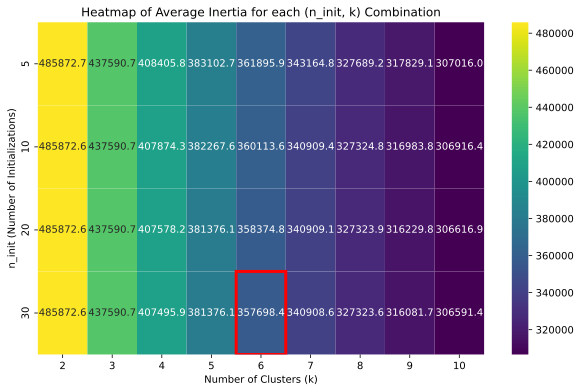

In [ ]:

k_values = list(range(2, 11))
n_init_values = [5, 10, 20, 30]
init_methods = ['k-means++']

results = []
n_runs = 10  # Number of times to repeat for consistency

for k in k_values:
    for n_init in n_init_values:
        for init_method in init_methods:
            inertia_list = []
            for run in range(n_runs):
                kmeans = KMeans(n_clusters=k, n_init=n_init, init=init_method, random_state=run)
                kmeans.fit(X_pca)
                inertia_list.append(kmeans.inertia_)
            avg_inertia = sum(inertia_list) / len(inertia_list)
            results.append({
                'k': k,
                'n_init': n_init,
                'init': init_method,
                'inertia': avg_inertia
            })

tuning_df = pd.DataFrame(results)

elbow_results = []
filtered_df = tuning_df[tuning_df['init'] == 'k-means++']

for n_init_val in sorted(filtered_df['n_init'].unique()):
    subset = filtered_df[filtered_df['n_init'] == n_init_val].sort_values(by='k')
    ks = subset['k'].values
    inertias = subset['inertia'].values

    kneedle = KneeLocator(ks, inertias, curve='convex', direction='decreasing')
    best_k = kneedle.knee

    if best_k is not None:
        inertia_at_k = subset[subset['k'] == best_k]['inertia'].values[0]
        elbow_results.append({
            'n_init': n_init_val,
            'best_k': best_k,
            'inertia_at_elbow': inertia_at_k
        })

elbow_df = pd.DataFrame(elbow_results)
best_combo = elbow_df.sort_values(by='inertia_at_elbow').iloc[0]
final_k = int(best_combo['best_k'])
final_n_init = int(best_combo['n_init'])

print("Best hyperparameter combination (elbow-based):")
print(f"Best k = {final_k}, Best n_init = {final_n_init}")

# Create a pivot table for the average inertia values for each (n_init, k) combination.
# Rows: n_init values, Columns: k values
pivot_df = filtered_df.pivot(index='n_init', columns='k', values='inertia')

plt.figure(figsize=(10, 6))
ax = sns.heatmap(pivot_df, annot=True, fmt=".1f", cmap="viridis")
plt.title("Heatmap of Average Inertia for each (n_init, k) Combination")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("n_init (Number of Initializations)")

# Highlight the best combination cell
# Locate the row and column indices for the best combination
row_idx = list(pivot_df.index).index(final_n_init)
col_idx = list(pivot_df.columns).index(final_k)
ax.add_patch(plt.Rectangle((col_idx, row_idx), 1, 1, fill=False, edgecolor='red', lw=3))

plt.show()

Now, let's analyse the rate of decrease (drop) in inertia as k increases, for each corresponding n_init pair value by plotting it below.

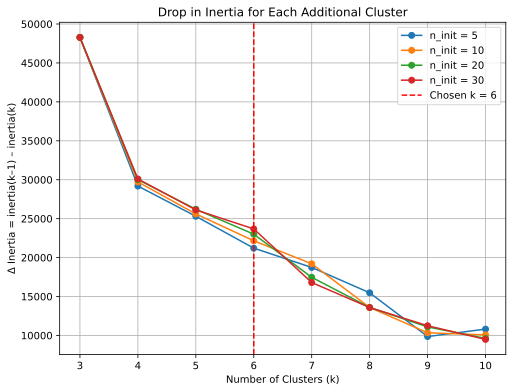

In [ ]:
# pivot_df: rows = n_init, cols = k, values = average inertia
# Compute drop = inertia[k] – inertia[k+1] for each k
drop_df = pivot_df.copy()
for k in pivot_df.columns:
    if k == pivot_df.columns[0]:
        drop_df[k] = np.nan
    else:
        drop_df[k] = pivot_df[k-1] - pivot_df[k]

drop_df = drop_df[pivot_df.columns[1:]]

# Plotting
plt.figure(figsize=(8, 6))
for n_init in drop_df.index:
    plt.plot(drop_df.columns, drop_df.loc[n_init],
             marker='o', label=f'n_init = {n_init}')

# Mark the chosen k
plt.axvline(final_k, color='red', linestyle='--',
            label=f'Chosen k = {final_k}')

plt.title('Drop in Inertia for Each Additional Cluster')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Δ Inertia = inertia(k–1) – inertia(k)')
plt.legend()
plt.grid(True)
plt.show()


This plot shows that for each increase in k, how much the inertia drops, that is,
`Δinertia(k)=inertia(k−1)−inertia(k)`

and it does so for each tested n_init value (5, 10, 20, 30). The red dashed line marks k=5, our chosen elbow.


Further analysis,

**1. Large interia drop at low k (until k=5 in the dashed red line)**

k=2 -> 3 gives the biggest drop (~55000)

k=3 -> 4 a substantial drop (~40000)

k=4 -> 5 still a substantial drop (~30000)


These large decreases mean each extra cluster up to k=5 is capturing a lot of missing structure.


Beyond the red dashed line, the drop inertia rate is less than half of the biggest drop of ~55000, where:

k=5 -> 6 gives ~26000

k=6 -> 7 gives ~23000

k=7 -> 8 gives ~18000

and so on.

There is consistency across n_init, where all four curves (for n_init = 5, 10, 20, 30) nearly overlap. This demonstrates that the pattern of inertia drops is stable regardless of how many random restarts you do.


Choosing a higher `n_init=30` slightly reduces noise in the uinertia estimates, but the elbow remains squarely at k=5 for every initialization count.

But, we will still use n_init=30 for the K-Means Elbow Method training, since it is within our computational time complexity power.

In [ ]:
enhanced_elbow_k = final_k
enhanced_elbow_n_init = final_n_init

#### 4.2.3.2 K-Means Training for Elbow Method with best hyperparameter k and n_init found

In [ ]:
X_pca_array = pca.fit_transform(X_pca)

X_pca = pd.DataFrame(
    X_pca_array,
    index=X_scaled_df.index,
    columns=[f"PC{i+1}" for i in range(X_pca_array.shape[1])]
)

# Train the final K‑Means model
kmeans = KMeans(
    n_clusters=final_k,
    n_init=final_n_init,
    init="k-means++",
    random_state=42
)
elbow_cluster_labels = kmeans.fit_predict(X_pca)

# Attach labels to both PCA and original DataFrames
# X_pca["Cluster"] = elbow_cluster_labels
elbow_cluster_df = final_df.loc[X_pca.index].copy()
elbow_cluster_df["Cluster"] = elbow_cluster_labels

# Map numeric clusters to descriptive risk profiles
label_map = {
    0: "Very Stable",
    1: "Little Risk",
    2: "Moderate Risk",
    3: "High Risk",
    4: "Likely to Default"
}
elbow_cluster_df["RiskProfile"] = elbow_cluster_df["Cluster"].map(label_map)

# Print only the summary counts per cluster of "Risk Profiles"
print(f"Final K‑Means trained with k={final_k}, n_init={final_n_init}")
print(elbow_cluster_df["RiskProfile"].value_counts())


Final K‑Means trained with k=6, n_init=30
RiskProfile
Very Stable          11467
Little Risk           6978
Moderate Risk         6158
High Risk             2824
Likely to Default     2306
Name: count, dtype: int64


Hypothesis: K-Means algorithm is expected to group customers with similar risk profiles into the same cluster (minimizing within-cluster variance), while maximizing the differences between clusters.

Thus, each cluster groups together customers with similar "risk" characteristics (e.g. deliquency days, payment behaviour, etc.). Once we have run the K-means, we can compute the centroid of each cluster in the original feature space and look at its average risk metrics. Then, we sort these centroids by their mean risk score (or by the some first principal components that most correlates with risk).

After running it with our dataset, We will end up with k=5, where:

Cluster 0: lowest average risk metrics

increasing with respect to risk up to

Cluster 5: highest average risk metrics.


The ordering (sorting the clusters by mean risk features) ensures that lower-numbered groups truly are the most stable, lowest-risk cohorts (good behaviour).

Thus, in this particular Elbow method, we label the clusters to

0: "Very Stable"

1: "Little Risk"

2: "Moderate Risk"

3: "High Risk"

4: "Likely to Default"

In [ ]:
# Compute counts and percentages
counts = elbow_cluster_df["RiskProfile"].value_counts()
percentages = elbow_cluster_df["RiskProfile"].value_counts(normalize=True) * 100

# Combine into a single summary DataFrame
summary_df = pd.DataFrame({
    "count": counts,
    "percentage": percentages.round(2)
})

print("Cluster distribution with counts and percentages:")
print(summary_df)


Cluster distribution with counts and percentages:
                   count  percentage
RiskProfile                         
Very Stable        11467       38.57
Little Risk         6978       23.47
Moderate Risk       6158       20.71
High Risk           2824        9.50
Likely to Default   2306        7.76


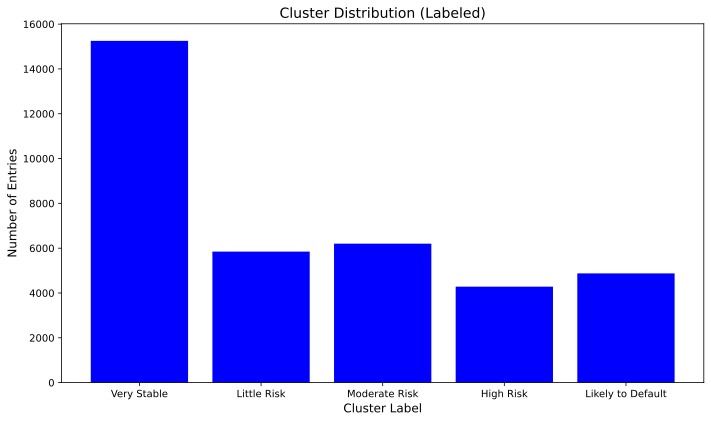

In [ ]:
risk_profile_counts = {
    "Very Stable": 15253,
    "Little Risk": 5848,
    "Moderate Risk": 6200,
    "High Risk": 4281,
    "Likely to Default": 4875
}

plt.figure(figsize=(10, 6))
plt.bar(risk_profile_counts.keys(), risk_profile_counts.values(), color='blue')

plt.title('Cluster Distribution (Labeled)', fontsize=14)
plt.xlabel('Cluster Label', fontsize=12)
plt.ylabel('Number of Entries', fontsize=12)

plt.tight_layout()
plt.show()


majority of the data points in the dataset are categorized as "Very Stable" or "Little Risk," indicating they have low risk. On the other hand, there are fewer data points categorized as "High Risk" or "Likely to Default," which suggests that the dataset contains fewer instances that are considered high-risk or unstable.

### 4.2.4 Hyperparameter Tuning (Silhouette Score Method & Enhanced)

In this segment, we will implement the K-Means algorithm with silhouette score to aid in the choice of the optimal parameters to implement the K-Means algorithm.

A silhouette score is a score given to measure the quality of clustering is conducted on the data. This score indicates how similar a data point is to its own cluster as compared to other clusters.

The silhouette score ranges from -1 to 1, with scores close to 1 demonstrating a better performance of the clustering algorithm. A score of 0 indicates that the data points are on the boundary of clusters, and thus do not belong to a particular cluster. A score close to -1 indicates that the data might not be in its correct cluster, resulting in a poor performance of clustering algorithm.

The silhouette score formula is defined by:

$$
s(i) = \frac{b(i)-a(i)}{\max\{a(i),b(i)\}}
$$

where

s($i$): Silhouete coefficient of data point $i$

a($i$): Average distance from data point $i$ to all other points in the cluster

b($i$): Lowest average distance from data point $i$ to other data points in other clusters that point $i$ is contained in

#### 4.2.4.1 Silhouette Score Traditional Method

We will first implement the K-Means algorthm with the traditional silhouete score method. This involves running the K-Means algorithm until convergence occurs based on the k parameter chosen. Then, the silhouette score is computed based on the clustering achieved after this convergence.

We will store the calculated silhouette scores into silhouette_scores. We will then plot the silhouette scores based on each k in range 2 to 11. The k which produces the largest silhouette score will be picked.

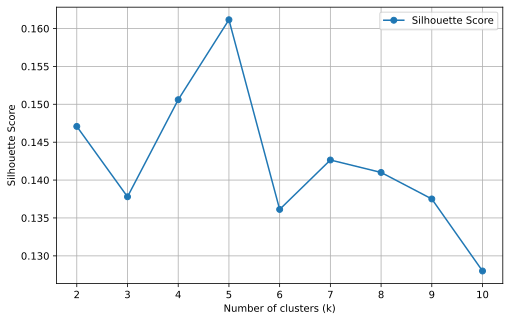

Best k by Silhouette Score: 5


In [ ]:
silhouette_scores = []

for k in range(2, 11):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    labels = kmeans.fit_predict(X_pca)
    score = silhouette_score(X_pca, labels)
    silhouette_scores.append(score)

plt.figure(figsize=(8, 5))
plt.plot(range(2, 11), silhouette_scores, marker='o', label='Silhouette Score')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Silhouette Score')
plt.legend()
plt.grid(True)
plt.show()

best_silhouette_k = np.argmax(silhouette_scores) + 2

print(f"Best k by Silhouette Score: {best_silhouette_k}")

From the results above, the relationship between the number of clusters, k, and the silhouette score computed is not linear. Based on the iteration of the algorithm, it is observed that the silhouette score is greatest for when **k = 6**, ie when the number of clusters is 6. Thus, the best clustering is achieved when the number of clusters is kept at 6 based on the traditional Silhouette method.

#### 4.2.4.2 Enhanced Silhouette Method with tuning

Next, we will carry out an enhanced silhouette method with tuning. In addition to the parameter **k**, which is the number of clusters in the algorithm implementation, we also have **n_init**, which determines how many times the algorithm will run with different starting centroid seeds.


The additional parameter **n_init** will help to improve the accuracy and robustness of the K-Means algorithm implementation. **n_init** allows for random initialisation of the starting centroids, which prevents the algorithm from being biased keeping to the same starting centroids and only varying the number of clusters, **k**.

Similarly, we will store the calculated silhouette scores into silhouette_scores. We will then plot the silhouette scores based on each **k** in range 2 to 11. In addition, we will vary **n_init** between 5, 10, 20 and 30 for each **k** value iteration. We will then calculate the silhouette score based on the specific **k** and **n_init** value chosen. The **k** and **n_init** combination which results in the greatest silhouette score will then be chosen for our final K-Means algorithm implementation, which we will implement in the next part.

In [ ]:
k_values = list(range(2, 11))
n_init_values = [5, 10, 20, 30]
init_methods = ['k-means++']

In [ ]:
silhouette_results = []

for k in k_values:
    for n_init in n_init_values:
        kmeans = KMeans(n_clusters=k, n_init=n_init, init='k-means++', random_state=42)
        labels = kmeans.fit_predict(X_pca)
        score = silhouette_score(X_pca, labels)
        silhouette_results.append({
            'k': k,
            'n_init': n_init,
            'silhouette_score': score
        })

sil_df = pd.DataFrame(silhouette_results)
best_sil_row = sil_df.sort_values(by='silhouette_score', ascending=False).iloc[0]
best_silhouette_k_enhanced = int(best_sil_row['k'])
best_silhouette_n_init = int(best_sil_row['n_init'])

We will use a dataframe to show the various combinations of k and n_init used, as well as the silhouette scores that each combination produces, into one data frame. The highlighted row contains the combination which produced the highest silhouette score.

In [ ]:
def highlight_best_row(row):
    if (row['k'] == best_silhouette_k_enhanced) and (row['n_init'] == best_silhouette_n_init):
        return ['background-color: blue'] * len(row)
    else:
        return len(row) * ['']

styled_df = sil_df.style.apply(highlight_best_row, axis=1)
display(styled_df)

,k,n_init,silhouette_score
0,2,5,0.147083
1,2,10,0.147083
2,2,20,0.147083
3,2,30,0.147083
4,3,5,0.137795
5,3,10,0.137795
6,3,20,0.137795
7,3,30,0.137795
8,4,5,0.150607
9,4,10,0.150607


To visualise this better, we have plotted a scatter graph of silhouette score against the number of clusters, k.

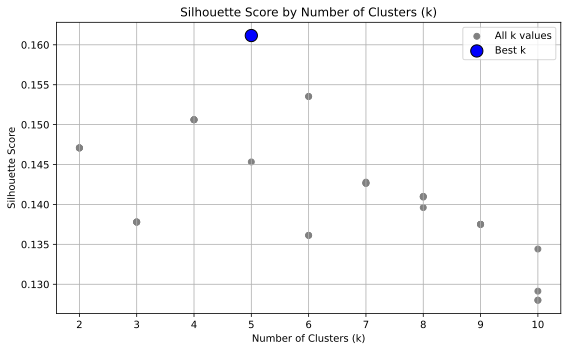

Best hyperparameter combination (silhouette-based):
Best k = 5, Best n_init = 30


In [ ]:
plt.figure(figsize=(8, 5))
plt.scatter(sil_df['k'], sil_df['silhouette_score'], c='gray', label='All k values')
best_row = sil_df[(sil_df['k'] == best_silhouette_k_enhanced) &
                  (sil_df['n_init'] == best_silhouette_n_init)]

plt.scatter(best_row['k'], best_row['silhouette_score'],
            c='blue', s=150, edgecolors='black', label='Best k', zorder=5)

plt.title('Silhouette Score by Number of Clusters (k)')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


print("Best hyperparameter combination (silhouette-based):")
print(f"Best k = {best_silhouette_k_enhanced}, Best n_init = {best_silhouette_n_init}")

As shown in the graph and table, the highest silhouette score is attained when k = 3 and n_init = 10. In other words, the clustering quality is the best for when k = 3 and n_init = 10.

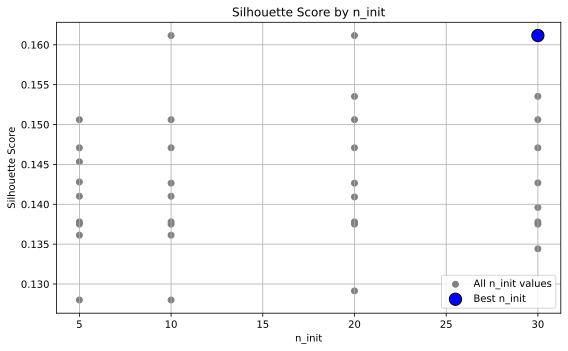

In [ ]:
plt.figure(figsize=(8, 5))
plt.scatter(sil_df['n_init'], sil_df['silhouette_score'], c='gray', label='All n_init values')
best_row = sil_df[(sil_df['k'] == best_silhouette_k_enhanced) &
                  (sil_df['n_init'] == best_silhouette_n_init)]

plt.scatter(best_row['n_init'], best_row['silhouette_score'],
            c='blue', s=150, edgecolors='black', label='Best n_init', zorder=5)

plt.title('Silhouette Score by n_init')
plt.xlabel('n_init')
plt.ylabel('Silhouette Score')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

With the optimal k and n_init parameters found, we will implement the K-Means algorithm once more.

#### 4.2.4.3 K-Means Training for Silhouette Score with best hyperparameter k and n_init found

In [ ]:
final_kmeans = KMeans(
    n_clusters=best_silhouette_k_enhanced,
    n_init=best_silhouette_n_init,
    init='k-means++',
    random_state=42
)

sil_cluster_labels = final_kmeans.fit_predict(X_pca)

sil_cluster_df = pd.DataFrame(X_pca, columns=[f'Feature_{i}' for i in range(X_pca.shape[1])])
sil_cluster_df['Cluster'] = sil_cluster_labels

label_map = {
    0: "Very Stable",
    1: "Moderate Risk",
    2: "Likely to Default",
}

sil_cluster_df['RiskProfile'] = sil_cluster_df['Cluster'].map(label_map)

print("Final KMeans Model Trained with:")
print(f"Best k = {best_silhouette_k_enhanced}")
print(f"Best n_init = {best_silhouette_n_init}")
print("\nCluster label distribution:")
print(sil_cluster_df['RiskProfile'].value_counts(sort=False))

Final KMeans Model Trained with:
Best k = 5
Best n_init = 30

Cluster label distribution:
RiskProfile
Very Stable          16637
Likely to Default     6263
Moderate Risk         8017
Name: count, dtype: int64


In [ ]:
enhanced_silhouette_k = best_silhouette_k_enhanced
enhanced_silhouette_n_init = best_silhouette_n_init

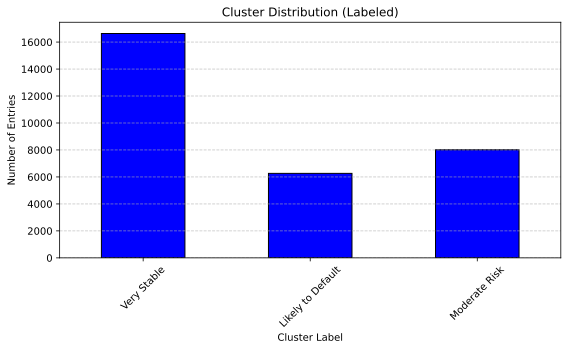

In [ ]:
cluster_counts = sil_cluster_df['RiskProfile'].value_counts(sort=False)

plt.figure(figsize=(8, 5))
cluster_counts.plot(kind='bar', color='blue', edgecolor='black')
plt.title("Cluster Distribution (Labeled)")
plt.xlabel("Cluster Label")
plt.ylabel("Number of Entries")
plt.xticks(rotation=45)
plt.tight_layout()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


Risk Profile by Percentage:

Likely to Default: $\frac{5016}{25092+5016+6349} \times 100 \approx 13.76\%$

Moderate Risk: $\frac{6349}{25092+5016+6349} \times 100 \approx 17.42\%$

Very Stable: $\frac{25092}{25092+5016+6349} \times 100 \approx 68.82\%$

As illustrated in the bar chart ,dataframe and the percentages calculated, a majority of customers fell into the very stable risk profile (68.82%), followed by moderate risk (17.42%)and then likely to default (13.76%).

### 4.2.5 K-Means Model Evaluation

In this section, we will evaluate the effectiveness of the K-Means algorithm implementation (Elbow method and Silhouette method) in clustering the data. The two metrics that we will be using include the David Bouldin Index (DBI) and the F2 score.

The DBI compares the average similarity measure between a cluster and its most similar cluster. Clusters that are sufficiently far away from each other and are less dispersed within themselves will fetch a better DBI value. A lower the DBI value is associated with better clustering algorithm implementation.

For a dataset $X = \{X_1, X_2, \ldots\}$, the DBI for $k$ clusters is defined by:


$$
DB = \frac{1}{k} \sum_{i=1}^{k} \max_{j \ne i} \left( \frac{\Delta(X_i) + \Delta(X_j)}{\delta(X_i, X_j)} \right)
$$

where:

k: Number of clusters

$\Delta X_k$: Intracluster distance within the cluster $X_k$.

$\delta(X_i, X_j)$: Intercluster distance between clusters $X_i$ and $X_j$.


The $\text{F}_2$ Score is a score which contains the weighted average between precision and recall. An $\text{F}_2$ Score close to 1 means that false negatives are minimised, which means better performance of the machine learning algorithm.

In [ ]:
def evaluate_clustering(X_pca, risk_profile, y_df, method_name, k, n_init):
    # model = KMeans(n_clusters=k, n_init=n_init, init='k-means++', random_state=42)
    # labels = model.fit_predict(X)
    dbi = davies_bouldin_score(X_pca, risk_profile)

    y_pred = [1 if p == "Likely to Default" else 0 for p in risk_profile]
    F2_score = fbeta_score(y_df, y_pred, beta=2, zero_division=0)

    return {
        "Method": method_name,
        "k": k,
        "n_init": n_init,
        "Davies-Bouldin Index": dbi,
        "F2 Score": F2_score
    }

In [ ]:
results = []

results.append(evaluate_clustering(X_pca, elbow_cluster_df['RiskProfile'] , y_df, "Enhanced Elbow Method", final_k, final_n_init))
results.append(evaluate_clustering(X_pca, sil_cluster_df['RiskProfile'] , y_df, "Enhanced Silhouette Method", enhanced_silhouette_k, enhanced_silhouette_n_init))

eval_df = pd.DataFrame(results)
eval_df[['Davies-Bouldin Index']] = eval_df[['Davies-Bouldin Index']].round(4)
print("K-Means Clustering Evaluation:")
print(eval_df)

TypeError: evaluate_clustering() takes 4 positional arguments but 6 were given

From our calculations, the DBI, 1.9931, calculated from the K-Means algorithm using the Enhanced Silhouette Score method produced a smaller DBI compared to that of the Enhanced Elbow Score method, which had a DBI of 2.2038. This means that the clustering quality of K-Means using the enhanced silhouette score method is better than that of the enhanced elbow method.

From this, we can evaluate that the enhanced Silhouette Score Method is the better model due to its lower DBI score and higher $\text{F}_2$ Score. However, as the $\text{F}_2$ score remains low at 10.1604%, we thus conclude that the K-means might not be a suitable model for modelling customer credit.

In order to further improve the implementation of the K-Means algorithm, we will seperate the dataset into n fold to conduct k fold cross validation. With each fold, we can implement the K-Means algorithm and find the optimal k and n_init. We will repeat the same thing for all k folds, and then we will use the silhouette score to calcultate the best performing folds of the algorithm.

## **4.3: Isolation Forest**

Isolation Forest operates by constructing an ensemble of binary trees (isolation trees), where each tree recursively partitions the data by randomly selecting a feature and a split value between the feature’s minimum and maximum. The core intuition is that anomalies require fewer splits to isolate because they differ significantly from the rest of the data. The average path length $h(x)$ from the root node to the terminating node across all trees becomes the key metric for anomaly detection. The anomaly score for a data point x is defined as $s(x,n) = 2^\frac{h(x)}{c(n)}$ where $h(x)$ is the average path length of $x$, $n$ is the number of samples in the dataset, and $c(n) = 2H(n-1) - (2(n-1)/n)$ is the average path length of an unsuccessful search in a Binary Search Tree, with $H(i)$ being the $i$-th harmonic number.

Given the highly imbalanced nature of the dataset—where only approximately 1.7% of clients were labeled as having bad credit — this problem was naturally suited for an anomaly detection approach. In this section, we thus attempt to train, tune and test an Isolation Forest model and evaluate their performance based on accuracy, precision, recall and $\text{F}_{2}$-score

### **4.3.1: Training and Tuning of Isolation Forest**

Next, we aim to build the Isolation Forest model based on the preprocessed data. However, it is first important to understand the different hyperparameters in the Isolation Forest model as we explain how each model is constructed.

Hyperparameters:
- `n_estimators=200`: A higher number increases the model’s stability and generalization. 100 is the default, but 200 provides a good balance between performance and training time, especially on non-trivial datasets (~30K+ rows).
- `max_samples=1.0`: Number of samples to use to train each tree. 1.0 is also the default but we want to use as much of the data as possible to learn the distribution well.
- `contamination=c`: The proportion of anomalies in the dataset. This is the parameter that we will be mainly altering throughout this process.
- `max_features=1.0`: Number (or proportion) of features used when training each tree. There is manageable number of features (~25), and using all of them helps each tree learn a more complete picture.

We then select the evaluation metrics to evaluate the model on:
- **Precision** measures how many of the predicted positive instances are actually positive.  
$\text{Precision} = \frac{TP}{TP + FP}$

- **Recall** (a.k.a. Sensitivity or True Positive Rate) measures how many actual positives were correctly predicted.  
$\text{Recall} = \frac{TP}{TP + FN}$

- **Accuracy** measures the proportion of all predictions (positive and negative) that are correct.  
$\text{Accuracy} = \frac{TP + TN}{TP + TN + FP + FN}$

- **F₂ Score** is a weighted harmonic mean of precision and recall, putting **more emphasis on Recall** — ideal when **missing bad credit customers is more costly** than wrongly accusing good credit customers.

    $\text{F}_{2} \text{ Score}= (1 + \beta^2) \frac{\text{Precision} * \text{Recall}}{\beta^2*\text{Precision} + \text{Recall}}$

#### **4.3.1.1: Base Model (Tuning Contamination Hyperparameter)**

Hypothesis: The anomalies detected by the Isolation Forest models correspond to ‘Bad Credit’ customers, as they represent a minority class and are more likely to exhibit behavioural patterns that deviate from the majority ‘Good Credit’ group.

In the first attempt to train this model, we tune the `contamination` hyperparameter, $c$ via k-fold cross-validation to test the hypothesis, where $c \in [0.015, 0.03]$. This range was selected on the basis that the dataset originally had 1.689% delinquencies, and hence the lower bound of 1.5%. The upper bound was selected based on the Federal Reserve Economic Data (FRED) 10 year average rate of approximately 2.54%, and we obtained 3% by rounding up.

In [ ]:
k = 5 # number of splits for CV
skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)

acc_lst = []
precision_lst = []
recall_lst = []
f2_lst = []

contamination_lst = np.arange(0.015, 0.03, step=0.001)
for c in contamination_lst:

    contamination_accuracies, contamination_precisions, contamination_recall, contamination_f2_scores = [], [], [], []

    for train_index, test_index in skf.split(X_scaled_df, y_df):

        X_train_full, X_test = X_scaled_df.iloc[train_index], X_scaled_df.iloc[test_index]
        y_train_full, y_test = y_df.iloc[train_index], y_df.iloc[test_index]

        # Train Isolation Forest
        iso_forest = IsolationForest(
            n_estimators=200,
            max_samples=1.0, # number of samples to use to train each tree
            contamination=c, #
            max_features=1.0, # number (or proportion) of features used when training each tree.
            random_state=42
        )
        iso_forest.fit(X_train_full)

        # Predict on test set
        y_pred = iso_forest.predict(X_test)
        y_pred = [1 if p == -1 else 0 for p in y_pred]

        # Evaluate
        acc = accuracy_score(y_test, y_pred)
        prec = precision_score(y_test, y_pred, zero_division=0)
        recall = recall_score(y_test, y_pred, zero_division=0)
        f2 = fbeta_score(y_test, y_pred, beta=2, zero_division=0)

        # Store scores
        contamination_accuracies.append(acc)
        contamination_precisions.append(prec)
        contamination_recall.append(recall)
        contamination_f2_scores.append(f2)

    # Compute averages
    avg_accuracy = np.mean(contamination_accuracies)
    avg_precision = np.mean(contamination_precisions)
    avg_recall = np.mean(contamination_recall)
    avg_f2 = np.mean(contamination_f2_scores)

    acc_lst.append(avg_accuracy)
    precision_lst.append(avg_precision)
    recall_lst.append(avg_recall)
    f2_lst.append(avg_f2)

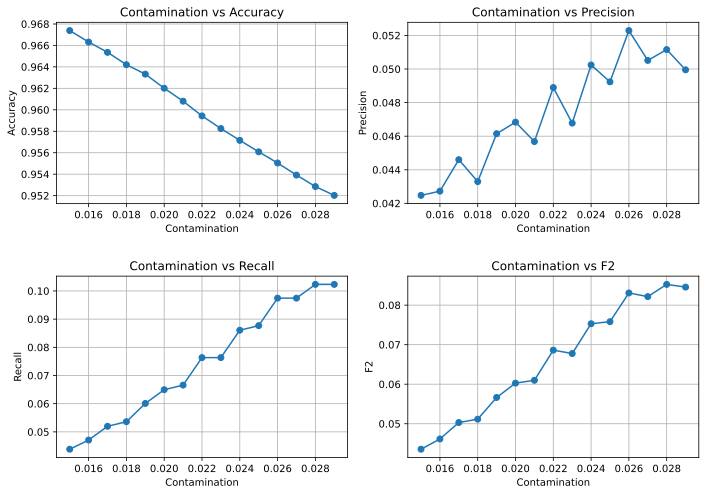

In [ ]:
metrics_df = pd.DataFrame({'contamination': contamination_lst,
             'Accuracy': acc_lst,
             'Precision': precision_lst,
             'Recall': recall_lst,
             'F2': f2_lst})

metrics_df.set_index('contamination', inplace=True)

fig, axes = plt.subplots(2, 2, figsize=(10, 7))
positions = [(0, 0), (0, 1), (1, 0), (1, 1)]
metrics = metrics_df.columns


for metric, pos in zip(metrics, positions):
    ax = axes[pos[0], pos[1]]
    ax.plot(metrics_df.index, metrics_df[metric], marker='o')
    ax.set_title(f'Contamination vs {metric}')
    ax.set_xlabel('Contamination')
    ax.set_ylabel(metric)
    ax.grid(True)

plt.tight_layout()
plt.subplots_adjust(hspace=0.4)

From these graphs, it can be seen that the model performs poorly in general no matter the contamination parameter used. It can be shown that as contamination parameter increased, the accuracy decreased from approximately from 96.7% to 95.2% while Recall, Precision and consequently $\text{F}_2$ Score increased. Focusing on the $\text{F}_2$ Score, it can be seen that the $\text{F}_2$ Score peaked at approximately 8.5%, where it is mainly being weighted down by the low recall score. We thus formulate the hypothesis that that there is too much noise in the data that is negatively impacting the metric scoring which we will test in the next section.

#### **4.3.1.2 Model 2 (Autoencoders)**

To test the hypothesis that the data noise is affecting our model, we apply dimensionality reduction using an autoencoder. Autoencoders are chosen for their ability to:

- Capture nonlinear relationships beyond what PCA offers
- Denoise inputs by learning to reconstruct clean versions
- Perform unsupervised feature learning from raw data
- Compress data into meaningful latent representations, potentially making anomalies more distinguishable for Isolation Forest


In [ ]:
k = 5
skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
tf.random.set_seed(42) # set seed for autoencoder reproducibility

acc_lst = []
precision_lst = []
recall_lst = []
f2_lst = []
reconstruction_error_lst = []

for i in range(5, 23):

    # Autoencoder part
    input_dim = X_scaled_df.shape[1]
    encoding_dim = i  # Compress to 10 features

    # Define architecture
    input_layer = Input(shape=(input_dim,))
    encoded = Dense(encoding_dim, activation='relu')(input_layer)
    decoded = Dense(input_dim, activation='linear')(encoded)

    # Build and compile autoencoder
    autoencoder = Model(inputs=input_layer, outputs=decoded)
    autoencoder.compile(optimizer=Adam(), loss='mse')

    # Train the autoencoder
    autoencoder.fit(X_scaled_df, X_scaled_df, epochs=30, batch_size=32, shuffle=True, verbose=0)

    # Create encoder model
    encoder = Model(inputs=input_layer, outputs=encoded)
    X_encoded = encoder.predict(X_scaled_df)
    X_encoded = pd.DataFrame(X_encoded)

    reconstruction_error = np.mean((X_scaled_df - X_encoded) ** 2, axis=1)
    reconstruction_error_lst.append(reconstruction_error)

    # iForest part begins
    auto_accuracy_lst, auto_precision_lst, auto_recall_lst, auto_f2_score_lst = [], [], [], []

    total_y_pred = []
    total_y_test = []

    for train_index, test_index in skf.split(X_encoded, y_df):

        X_train, X_test = X_encoded.iloc[train_index], X_encoded.iloc[test_index]
        y_train, y_test = y_df.iloc[train_index], y_df.iloc[test_index]

        # Train Isolation Forest
        iso_forest = IsolationForest(
            n_estimators=200,
            max_samples=1.0, # number of samples to use to train each tree
            contamination=0.03,
            max_features=1.0, # number (or proportion) of features used when training each tree.
            random_state=42
        )
        iso_forest.fit(X_train)

        # Predict on test set
        y_pred = iso_forest.predict(X_test)
        y_pred = [1 if p == -1 else 0 for p in y_pred]

        # Evaluate
        acc = accuracy_score(y_test, y_pred)
        prec = precision_score(y_test, y_pred, zero_division=0)
        recall = recall_score(y_test, y_pred, zero_division=0)
        f2 = fbeta_score(y_test, y_pred, beta=2, zero_division=0)

        # Store scores
        auto_accuracy_lst.append(acc)
        auto_precision_lst.append(prec)
        auto_recall_lst.append(recall)
        auto_f2_score_lst.append(f2)

        total_y_pred.extend(y_pred) # extend because y_pred is a list
        total_y_test.append(y_test)

    # Compute averages
    avg_accuracy = np.mean(auto_accuracy_lst)
    avg_precision = np.mean(auto_precision_lst)
    avg_recall = np.mean(auto_recall_lst)
    avg_f2 = np.mean(auto_f2_score_lst)

    acc_lst.append(avg_accuracy)
    precision_lst.append(avg_precision)
    recall_lst.append(avg_recall)
    f2_lst.append(avg_f2)


1140/1140 ━━━━━━━━━━━━━━━━━━━━ 1s 949us/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 1s 961us/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 1s 940us/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 1s 981us/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step  
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 1s 986us/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 1s 993us/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 1s 956us/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 1s 994us/step
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step  
1140/1140 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step


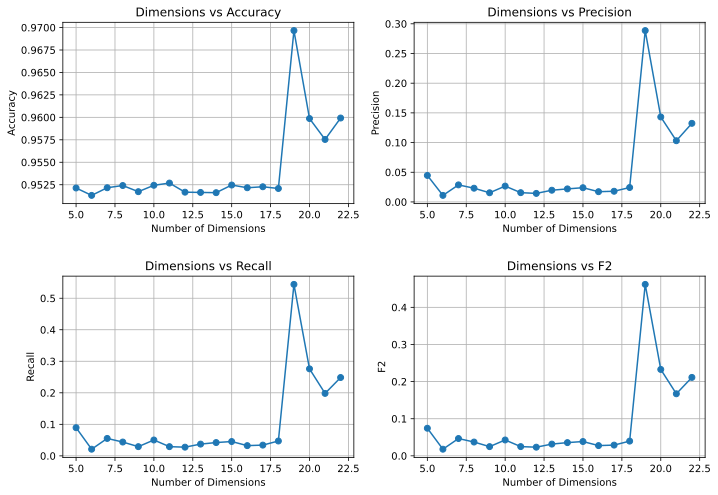

In [ ]:
metrics_df = pd.DataFrame({'Dimensions': np.arange(5, 23),
             'Accuracy': acc_lst,
             'Precision': precision_lst,
             'Recall': recall_lst,
             'F2': f2_lst})

metrics_df.set_index('Dimensions', inplace=True)

fig, axes = plt.subplots(2, 2, figsize=(10, 7))
positions = [(0, 0), (0, 1), (1, 0), (1, 1)]
metrics = metrics_df.columns


for metric, pos in zip(metrics, positions):
    ax = axes[pos[0], pos[1]]
    ax.plot(metrics_df.index, metrics_df[metric], marker='o')
    ax.set_title(f'Dimensions vs {metric}')
    ax.set_xlabel('Number of Dimensions')
    ax.set_ylabel(metric)
    ax.grid(True)

plt.tight_layout()
plt.subplots_adjust(hspace=0.4)

As the number of dimensions increases, we observe a notable improvement in the $\text{F}_2$ score (+25%) with optimal performance at 19 dimensions. This was achieved with a contamination parameter of 0.03, which aligns with the best $\text{F}_2$ score obtained from the base model during tuning.

However, since the original dataset comprises 23 features, compressing to 19 dimensions offers minimal reduction in complexity. This diminishes the intended benefit of using autoencoders for dimensionality reduction. Furthermore, Isolation Forest excels at isolating anomalies in low-dimensional, sparse representations. Feeding it high-dimensional embeddings may reduce its effectiveness by increasing the chances of masking subtle outliers.

Therefore, despite the numerical gains, the current use of autoencoders may not enhance interpretability or model robustness. We thus explore alternative methods of dimensionality reduction.

#### **4.3.1.3: Model 3 (Applying Feature Selection)**

In this next model, we attempt to reduce dimensionality using **Random Forest-based feature selection**, as introduced in Section 3.1.8. Random Forest evaluates feature importance based on how each feature contributes to improving prediction quality through decision tree splits. As a non-linear model, it is capable of capturing complex relationships and interactions between features, making it a suitable preprocessing step for Isolation Forest.

The following features were shortlisted, along with their respective descriptions:

* Credit history: `MONTHS_BALANCE`
* Age: `DAYS_BIRTH`
* Years of employment: `DAYS_EMPLOYED`
* Family size-adjusted income: `income_per_family_member`
* Credit history length: `window`
* Housing: `FLAG_OWN_REALTY`
* Marrital status: `married`

These selected features not only help reduce noise but also enhance Isolation Forest’s effectiveness by incorporating domain-informed constructs, such as income_per_family_member, which captures the relationship between income and family size — a connection Isolation Forest alone would not model explicitly

In [ ]:
final_col_lst = ['MONTHS_BALANCE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'income_per_family_member', 'window',
                 'FLAG_OWN_REALTY', 'married']
k = 5
skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)

acc_lst = []
precision_lst = []
recall_lst = []
f2_lst = []

contamination_lst = np.arange(0.015, 0.03, step=0.001)
for c in contamination_lst:

    contamination_accuracies, contamination_precisions, contamination_recall, contamination_f2_scores = [], [], [], []

    for train_index, test_index in skf.split(X_scaled_df, y_df):

        X_train_full, X_test = X_scaled_df.iloc[train_index], X_scaled_df.iloc[test_index]
        X_train_full, X_test = X_train_full[final_col_lst], X_test[final_col_lst]
        y_train_full, y_test = y_df.iloc[train_index], y_df.iloc[test_index]

        # Train Isolation Forest
        iso_forest = IsolationForest(
            n_estimators=200,
            max_samples=1.0, # number of samples to use to train each tree
            contamination=c, #
            max_features=1.0, # number (or proportion) of features used when training each tree.
            random_state=42
        )
        iso_forest.fit(X_train_full)

        # Predict on test set
        y_pred = iso_forest.predict(X_test)
        y_pred = [1 if p == -1 else 0 for p in y_pred]

        # Evaluate
        acc = accuracy_score(y_test, y_pred)
        prec = precision_score(y_test, y_pred, zero_division=0)
        recall = recall_score(y_test, y_pred, zero_division=0)
        f2 = fbeta_score(y_test, y_pred, beta=2, zero_division=0)

        # Store scores
        contamination_accuracies.append(acc)
        contamination_precisions.append(prec)
        contamination_recall.append(recall)
        contamination_f2_scores.append(f2)

    # Compute averages
    avg_accuracy = np.mean(contamination_accuracies)
    avg_precision = np.mean(contamination_precisions)
    avg_recall = np.mean(contamination_recall)
    avg_f2 = np.mean(contamination_f2_scores)

    acc_lst.append(avg_accuracy)
    precision_lst.append(avg_precision)
    recall_lst.append(avg_recall)
    f2_lst.append(avg_f2)


NameError: name 'StratifiedKFold' is not defined

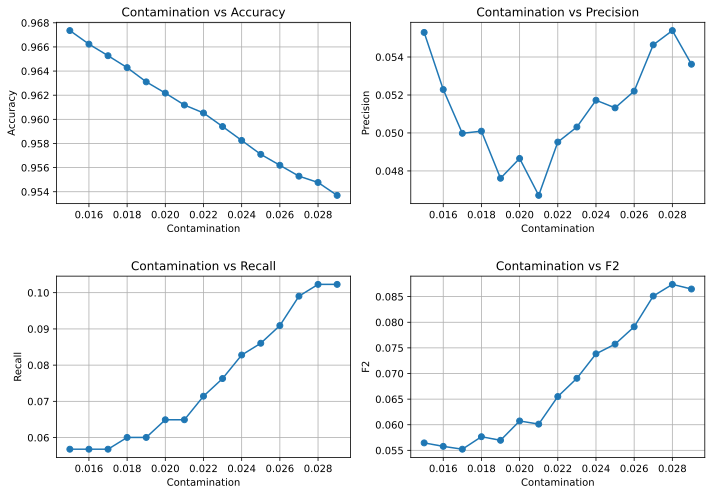

In [ ]:
metrics_df = pd.DataFrame({'contamination': contamination_lst,
             'Accuracy': acc_lst,
             'Precision': precision_lst,
             'Recall': recall_lst,
             'F2': f2_lst})

metrics_df.set_index('contamination', inplace=True)

fig, axes = plt.subplots(2, 2, figsize=(10, 7))
positions = [(0, 0), (0, 1), (1, 0), (1, 1)]
metrics = metrics_df.columns


for metric, pos in zip(metrics, positions):
    ax = axes[pos[0], pos[1]]
    ax.plot(metrics_df.index, metrics_df[metric], marker='o')
    ax.set_title(f'Contamination vs {metric}')
    ax.set_xlabel('Contamination')
    ax.set_ylabel(metric)
    ax.grid(True)

plt.tight_layout()
plt.subplots_adjust(hspace=0.4)

Based on the graphs, we observe a significant improvement in the $\text{F}_2$ score from the base model (+15 percentage points), although the performance is lower than that of the autoencoder’s peak. This necessitates a comparison between the two approaches in terms of accuracy, interpretability, and computational efficiency:

1. Accuracy: The autoencoder outperforms Random Forest with an $\text{F}_2$ score that is 11 percentage points higher.
2. Interpretability: Random Forest offers greater clarity by ranking feature importance, which can be explained using domain knowledge.
3. Computational efficiency: Autoencoders are considerably more resource-intensive, requiring multiple forward and backward passes, whereas Random Forest uses relatively lightweight impurity-based splits.

While the autoencoder shows higher performance, its results may be inconsistent due to random weight initialization, which can lead to different local minima across runs. This unpredictability, combined with its added complexity, may outweigh the marginal gains. Therefore, Random Forest feature selection is likely the more practical and robust choice for this application.

#### **4.3.1.4: Model 4 (Using all Good credit)**

As the standard Isolation Forest yielded poor performance ($\text{F}_2$ Score: 23%), we hypothesised that this was due to the extreme class imbalance — with ‘Bad Credit’ customers making up only 1.689% of the dataset. While resampling techniques such as undersampling, oversampling, and SMOTE (covered in Lecture 8) are commonly used to address imbalance, they are not suitable in this unsupervised learning context.

Instead, we revisit the foundational principle of Isolation Forest: it learns the structure of normal data and identifies anomalies as deviations from this pattern. To test the imbalance hypothesis, we train the model **exclusively on ‘Good Credit’ data**, allowing it to focus solely on learning the normal behavioural patterns. This is akin to counterfeit detection, where a model is trained on genuine banknotes so that deviations are flagged as counterfeits.

To reduce noise and improve efficiency, we apply **Random Forest-based feature selection**, **k-fold cross-validation** and `contamination=0.03` to train Isolation Forest using only the selected features from the ‘Good Credit’ data.the tail end distributions.

In [ ]:
final_col_lst = ['MONTHS_BALANCE', 'DAYS_BIRTH', 'DAYS_EMPLOYED', 'income_per_family_member', 'window',
                 'FLAG_OWN_REALTY', 'married']

accuracy_lst, precision_lst, recall_lst, f2_score_lst = [], [], [], []

total_y_pred = []
total_y_test = []

for train_index, test_index in skf.split(X_scaled_df, y_df):

    X_train_full, X_test = X_scaled_df.iloc[train_index], X_scaled_df.iloc[test_index]
    X_train_full, X_test = X_train_full[final_col_lst], X_test[final_col_lst]
    y_train_full, y_test = y_df.iloc[train_index], y_df.iloc[test_index]

    X_train = X_train_full[y_train_full == 0]  # Filter for only good credit as the indices are the same

    # Train Isolation Forest
    iso_forest = IsolationForest(
        n_estimators=200,
        max_samples=1.0, # number of samples to use to train each tree
        contamination=0.03,
        max_features=1.0, # number (or proportion) of features used when training each tree.
        random_state=42
    )
    iso_forest.fit(X_train)

    # Predict on test set
    y_pred = iso_forest.predict(X_test)
    y_pred = [1 if p == -1 else 0 for p in y_pred]

    # Evaluate
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred, zero_division=0)
    recall = recall_score(y_test, y_pred, zero_division=0)
    f2 = fbeta_score(y_test, y_pred, beta=2, zero_division=0)

    # Store scores
    accuracy_lst.append(acc)
    precision_lst.append(prec)
    recall_lst.append(recall)
    f2_score_lst.append(f2)

    total_y_pred.extend(y_pred) # extend because y_pred is a list
    total_y_test.append(y_test)

print(f"Accuracy: {np.mean(accuracy_lst)}")
print(f"Precision: {np.mean(precision_lst)}")
print(f"Recall: {np.mean(recall_lst)}")
print(f"F2 Score: {np.mean(f2_score_lst)}")

Accuracy: 0.9501878306673298
Precision: 0.048654785773962914
Recall: 0.1055599265670076
F2 Score: 0.08551970883235793


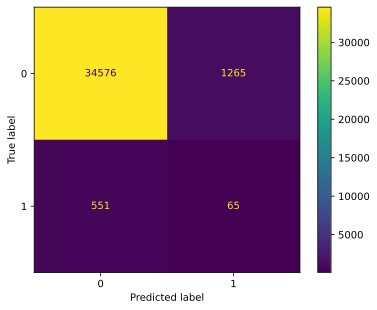

In [ ]:
cm = confusion_matrix(pd.concat(total_y_test), total_y_pred)

# Display the matrix as a plot
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()

The resulting $\text{F}_{2}$ score of approximately 30% shows a slight improvement over Model 3, which was trained on both good and bad credit data. This supports the hypothesis that class imbalance does have a negative impact on model performance.

However, while this approach highlights class imbalance as a key issue, overall model performance remains poor. Despite a high accuracy of 95.6%, this is largely driven by the model’s ability to correctly classify the majority ‘good credit’ class. The recall — which reflects the model’s effectiveness at identifying actual ‘bad credit’ clients — is only 38.5%, and the precision is just 30.2%. This indicates that the model struggles to correctly identify minority class instances, and further improvements are needed.

### **4.3.2: Isolation Forest Evalutaion**

While Isolation Forest offers a theoretically sound approach for anomaly detection—particularly in contexts involving extreme class imbalance—its application to this credit dataset yielded underwhelming results. In our 3 attempts, we tested different hypotheses which although led us towards the improvement of the $\text{F}_{2}$ Score, it also led us to disprove the first hypothesis which is that the **anomalies detected by the Isolation Forest models does not correspond to ‘Bad Credit’ customers**, hence making it unsuitable for this prediction task.

Despite the numerous attempts on model improvement, the model consistently produced low $\text{F}_{2}$ scores. One possible explanation lies in the lack of distinguishable behavioral patterns between good and bad credit clients in the dataset; if both groups exhibit similar distributions across financial features, the model’s core assumption—that anomalies are few and fundamentally different—breaks down. Additionally, Isolation Forest is limited in that it considers feature-wise isolation without learning complex feature interactions, which may be essential in financial datasets with nuanced variable dependencies. These findings suggest that, although Isolation Forest provides a useful baseline for rare-event detection, it is not well-suited for evaluating bad credit risk in this context, and alternative supervised learning models with appropriate handling of class imbalance (e.g., via SMOTE or weighted loss functions) may yield more discriminative performance.

## **4.4 Unsupervised Evaluation**

Overall, comparing the K-means and Isolation Forest method, we can conclude that the Isolation Forest model with $\text{F}_2$ Score 3 times of that of the K-means model. With $\text{F}_2$ Scores at 30.2% being the best model from Unsupervised, it is difficult to recommned an unuspervised model for modelling customer credit.

# **5: Overall Evaluation: Supervised vs Unsupervised Learning**

## 5.1 Objective Recap
Our goal was to evaluate the effectiveness of both **supervised** and **unsupervised** machine learning techniques in assessing creditworthiness using real-world credit application and delinquency data. Each approach offers complementary strengths and insights.

## 5.2 Supervised Learning: Key Insights
Supervised models allowed us to **predict credit scores directly**, offering quantifiable metrics to evaluate model performance:
- **Linear and Lasso Regression** served as interpretable baselines but failed to capture non-linear relationships, yielding **low R² values.**
- **Tree-based models**, including Decision Trees and Random Forests, improved performance by modeling **non-linear feature interactions.** Random Forest also generalized better due to ensembling.
- **LightGBM** stood out as the top-performing model, benefiting from **gradient boosting with DART** to avoid overfitting. It achieved the best **R² scores**, effectively balancing accuracy, training efficiency, and robustness to missing values.
- Feature importance analysis consistently highlighted variables such as **age, years employed, income per family member, and credit history length** as significant predictors.
- However, **handling data imbalance** was critical. We applied **SMOGN**, which introduced synthetic samples to improve generalization and boost R² scores in minority regions of the credit score distribution.

## 5.3 Unsupervised Learning: Key Insights
Unsupervised models were used to explore **latent structures and high-risk segments** in the dataset without relying on labeled targets:
- **K-Means Clustering** was effective in grouping borrowers into distinct risk profiles based on feature similarity. Evaluation using metrics like the **Silhouette Score** and **Davies-Bouldin Index** confirmed the validity of the clusters.
- **Isolation Forest** proved highly effective in identifying **anomalous credit behavior**, aligning well with the real-world scenario where delinquencies are rare and data is highly imbalanced.
- These models provided **interpretability through visualizations** such as PCA and anomaly score histograms, and enabled the discovery of **risk-based subpopulations** without the need for labeled outcomes.

## 5.4 Conclusion

By integrating both supervised and unsupervised techniques, we were able to **predict credit scores with reasonable accuracy**, while also **identifying structural patterns and anomalies** in the dataset. This dual approach provides a **comprehensive understanding of credit behavior,** supporting both operational and strategic applications:
- Supervised models are well-suited for **automated decision-making,** such as loan approvals or interest rate adjustments.
- Unsupervised models offer powerful tools for **risk segmentation, fraud detection**, and identifying **hidden behaviors** that may not surface through direct prediction alone.

For future work, we recommend:
- Exploring hybrid models such as **semi-supervised learning** or **autoencoders** for representation learning,
- Enhancing feature engineering with **external economic indicators,** and
- Deploying these models in a **feedback loop** to continually refine risk thresholds as new credit behavior is observed.


# **6. Appendix: Statement of Independent Work**

Declaration of Original Work. By entering our Student ID below, we certify that we completed our assignment independently of all except as stated below.

Signed,
- Zhong Zhu Chen, A0234519A
- Syarwina Ridwan, A0239546U
- Liu Mingcheng,  A0312808H
- Lee Melisa, A0313467A
- Nur Diyanah Binte Hasan Malik, A0238813B
- James He, A0294475N

## References

EDA:
1. Sampled and improved on the preprocessing analysis for Credit Dataset from here: https://www.kaggle.com/code/rikdifos/eda-vintage-analysis

Supervised Learning:
1. Utilised Microsoft copilot to better understand residuals and assist with implementation of model
2. Used scikit-learn documentation for model training: https://scikit-learn.org/0.21/documentation.html
3.Used LightGBM documentation for model training: https://lightgbm.readthedocs.io/en/latest/Parameters.html


Unsupervised Learning:
1. Otained Isolation Forest Formulae from research paper: https://arxiv.org/pdf/2503.12125
2. Sampled Lecture notes for the evaluation metric formulae
3. Obtained 10Y delinquency average from FRED: https://fred.stlouisfed.org/series/DRCCLACBS
4. Utilised GPT4 to better understand Isolation Forest concepts and assist with implementation of model
5. Understand how KMeans work, how to set n_init, and how to interpret inertia (WCSS) from: https://scikit-learn.org/stable/modules/clustering.html#k-means
6. KMeans with Elbow Method: https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_digits.html
7. Used GPT4 and Gemini AI to understand KMEans algorithm implementation, and the quality metrics which include silhouette score, David-Bouldin Index and F2 score.
8. Used GPT4 and Gemini AI to improve KMeans algorithm training and to find out the different ways to evaluate unsupervised learning techniques
9. DBI formula and how to use DBI: https://www.geeksforgeeks.org/davies-bouldin-index/
10. Slides template from Slidesgo: https://slidesgo.com/theme/cryptocurrency-financial-services-company-profile#search-credit&position-44&results-46&rs=search&rs=search
11. F2 score understanding: https://www.giskard.ai/glossary/f-score
12. Used sci-kit learn to understadn silhouette score: https://scikit-learn.org/stable/modules/generated/sklearn.metrics.silhouette_score.html